## Импортируем библиотеки

In [1]:
import os
import io
import numpy as np
import pandas as pd
import glob
import matplotlib.pyplot as plt
import re   # регулярные выражения

from tensorflow.keras import utils
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Conv1D, MaxPooling1D, GlobalMaxPooling1D, Dropout, Dense, Flatten, LSTM, GRU

from tensorflow.keras.callbacks import ModelCheckpoint


## Загружаем данные

Сразу же начнем производить предобработку данных:
 * Удаление HTML-хэштегов;
 * Удаление цифр (чисел);
 * Удаление пунктуации;

#### Неразмеченные данные для embedding 

In [2]:
#i=0
#data_unlabeled = list()

#for filename in glob.glob('C:/NLP/aclImdb/train/unsup/*.txt'):
#    with io.open(os.path.join(os.getcwd(), filename), 'r', encoding='utf-8') as f:
#        f.seek(0)
#        text = f.read()
#        text = re.sub(pattern = '<br', repl = '', string = text)
#        text = re.sub(pattern = '/>', repl = '', string = text)
#        text = re.sub(pattern = '\'', repl = '', string = text)
#        text = re.sub(pattern = '[1234567890]', repl = '', string = text)
#        text = re.sub(pattern = '[\"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~]', repl = '', string = text)
        
#        data_unlabeled.append([text])
#        print(i)
#        print(filename)
#        print (data_unlabeled[i])
#        i+=1
#        f.close()

In [3]:
#df_unlabeled = pd.DataFrame(data=data_unlabeled, columns=['text'])
#df_unlabeled

### Обучающая выборка
#### Позитивные отзывы

In [4]:
i=0
data_pos_train = list()

for filename in glob.glob('C:/NLP/aclImdb/train/pos/*.txt'):
    with io.open(os.path.join(os.getcwd(), filename), 'r', encoding='utf-8') as f:
        f.seek(0)
        text = f.read()
        text = re.sub(pattern = '<br', repl = '', string = text)
        text = re.sub(pattern = '/>', repl = '', string = text)
        text = re.sub(pattern = '\'', repl = '', string = text)        
        text = re.sub(pattern = '[1234567890]', repl = '', string = text)
        text = re.sub(pattern = '[\"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~]', repl = '', string = text)
        data_pos_train.append([text, filename[-5]])
        print(i)
        print(filename)
        print (data_pos_train[i])
        i+=1
        f.close()

0
C:/NLP/aclImdb/train/pos\0_9.txt
['Bromwell High is a cartoon comedy It ran at the same time as some other programs about school life such as Teachers My  years in the teaching profession lead me to believe that Bromwell Highs satire is much closer to reality than is Teachers The scramble to survive financially the insightful students who can see right through their pathetic teachers pomp the pettiness of the whole situation all remind me of the schools I knew and their students When I saw the episode in which a student repeatedly tried to burn down the school I immediately recalled  at  High A classic line INSPECTOR Im here to sack one of your teachers STUDENT Welcome to Bromwell High I expect that many adults of my age think that Bromwell High is far fetched What a pity that it isnt!', '9']
1
C:/NLP/aclImdb/train/pos\10000_8.txt
['Homelessness or Houselessness as George Carlin stated has been an issue for years but never a plan to help those on the street that were once considered 

227
C:/NLP/aclImdb/train/pos\10204_8.txt
['Although not the best Anime I have ever seen but I enjoyed Lady Death  I have never read the comic book and just saw this at the video store and decided to give it a chance  The animation was OK I got the sense of the s anime from it which is what set it off for me Why everyone else hates that is beyond me  Character development was fine I like how they brought the transition from Hope to Lady Death around for you who dont like it obviously wasnt paying attention Lucifer tells you how it happens and she used his words  Creamtor was a nice mentorsoldier for her his dark bruiting style was perfect for this kind of movie  I think everyone here who has bashed this needs to take another look at it and reconsider cause everything people have bashed this can be said about everyones favorite anime Vampire Hunter D', '8']
228
C:/NLP/aclImdb/train/pos\10205_10.txt
['REnted this one accidentally it was behind the movie box of what i thought i was renting

430
C:/NLP/aclImdb/train/pos\10388_7.txt
['Im a huge fan of the Dukes of Hazzard TV show And I really enjoyed this flick I enjoyed myself here a lot more than I did with other summer blockbusters  Its funny hearing people rail against this movie with excuses like lame plot and its much cruder than the show Does ANYONE remember the crudeness of the humor in the pilot episode Daisy makes incest jokes and Bo says that Luke had probably fathered half the kids in the orphanage The only reason it was cleaned up is because it changed to and earlier time slot  And as far as the plot goes It was the perfect Dukes plot In fact as a remake it probably stays truer to the source material than any TV show that has migrated to the big screen  While Sean William Scott and Johnny Knoxville arent EXACTLY like their small screen versions they do a great job and work very well together I wasnt too keen on Burts Boss Hogg though And I would have like a little bit more incompetence from Sheriff Roscoe In th

661
C:/NLP/aclImdb/train/pos\10596_8.txt
['Every time this film is on the BBC somebody in the Radio Times says how it is a satire against the post war world of rationing and the welfare state I do not think this is the point of the film at all The film parodies the spivssmall time criminals who ran the blackmarket and the housewives league who campaigned against government restrictions but were really a Tory front organisation  Yes of course the film sends up the politicalsocial situation but in the end the people realise that they need all the controls to ensure a fair societythey want to be British and muddle through rather than foreign  But I dont think they go back to being exactly like they were before', '8']
662
C:/NLP/aclImdb/train/pos\10597_9.txt
['I commend pictures that try something different Many films just seem like retreads of old ideas so that is the big reason I so strongly recommend Passport to Pimlico  The movie is set just after WW and the postwar shortages and ratio

898
C:/NLP/aclImdb/train/pos\10809_10.txt
['Russell my fav is gorgeous in this film But more than that the film covers a tremendous range of human passion and sorrow Everything from marriage to homosexuality is addressed and respected The film makes the viewer realize that tolerance of other humans provides the route to saving humanity Fabulous love story between Lachlin and Lil I replay their scenes over and over again Anyone who has ever been in love will empathize with these people All characters are cast and portrayed excellently', '0']
899
C:/NLP/aclImdb/train/pos\1080_9.txt
['Movie comedies nowadays are generally  minutes of toilet humor foul language and groinkicking Modern comedies appeal to the lowest common denominator the undemanding and slow of brain Sure an occasional good comedy will come along but theyre becoming rarer all the time  Mr Blandings Buildings his Dream House shows what s Hollywood was capable of and its just screamingly funny Jim and Muriel Blandings Cary Gr

1001
C:/NLP/aclImdb/train/pos\10901_10.txt
['This is probably the best documentary I have seen in a very long time Jonny Kennedy was and is still is a tragically beautiful inspiration Not only was he a survivor of one of the most painful diseases out there but he used his beauty to show the world that there is life after death and never to give up reaching people and spreading his love Watching minutes of his life long struggle was heartwrenching Listening to his smart ass remarks and seeing his adorable gestures was heartwarming And seeing him smile was indescribable I feel blessed to have been able to be touched by this tiny giant Please if you ever have a chance to watch this film  consider yourself lucky to have met Jonny Kennedy', '0']
1002
C:/NLP/aclImdb/train/pos\10902_10.txt
['i was greatly moved when i watched the moviehow jonny could keep such hope and faith was amazing so many people only care about what they want  and fuss about all the things they dont have  and they are s

1211
C:/NLP/aclImdb/train/pos\11090_8.txt
['Successful selfmade married businessman Harry Mitchell a superbly steely performance by Roy Scheider has an adulteress fling with sweetnsexy young stripper Cini the gorgeous Kelly Preston Harrys blackmailed by a trio of scummy lowlife hoods  sleazy porno theater manager Raimy a splendidly slimy John Glover antsy strip joint owner Leo well played by Robert Trebor and crazed pimp Bobby Shy a frightfully intense Clarence Williams III  who have videotaped his affair with Cini When Harry refuses to pay up the hoods kill Cini and make it look like Harry did it This in turn ignites a dangerous battle of wit and wills between Harry and the hoods Director John Frankenheimer adopting a tough script based on Elmore Leonards gritty crime thriller novel expertly maintains a steady snappy pace delivers plenty of gripping tension and effectively creates a compellingly seedynsordid atmosphere The leads are all uniformly excellent with standout supporting tur

1423
C:/NLP/aclImdb/train/pos\11281_8.txt
['This splendidlydirected fantasy is the second in the popular by flawed Tarzan series put out by MGM It is a firstclass adventure for many reasons I suggestfine photography strong imaginative qualities a delightful cast good simulatedjungle locales and a very exciting storyline Johnny Weissmuller plays Tarzan a monosyllabic untutored sort unlike Edgar Rice Burroughs creation but he is honest loyal brave and very courageous and he needs to be during this narrative As Jane Parker his wife who had been Jane Porter in the novels Maureen OSullivan is very attractive and lively as well as being athletic where the script calls for that quality The effect of the lighting the spacious and clever sets is quite unusual This is an outdoor adventure filmed on the MGM backlot which really works The fabulous Mutir Escarpment is a remote locale which allows Tarzan and Jane to live undisturbed but into their idyll come people searching from them emissaries of 

1621
C:/NLP/aclImdb/train/pos\1145_8.txt
['This is a romantic comedy with the emphasis on comedy for a change As usual the loversSally Field as almostoverthehill soap opera queen Celeste Talbert and Kevin Kline as marginally employed and marginally talented actor Jeffrey Andersonare working at cross purposes seemingly unaware that they are madly in love etc Owing a little to Bette Daviss Margo Channing in All About Eve  and a whole lot to the slapstick theatrical tradition Sally Field goes over the top towards hilarity as she malaprops her way to love and happiness Kevin Kline one of the more underrated leading men of recent years is also very good and very winning as he manages to be handsome vulnerable egotistical and lovable all at the same time  The misadventures center around Celestes fear of losing her audience as she has entered her forties and reach the crisis point with the arrival of her niece aspiring actress Cori Craven Elisabeth Shue who turns out NOT to be her niece with 

1860
C:/NLP/aclImdb/train/pos\11675_10.txt
['I always follow the Dakar so when my husband bought Charlies Race to Dakar DVD home I couldnt wait to watch it! Of course wed seen the broadcast of the race when the actual race was on but that never gives the background and specific teams  If you watched Long Way Round then you wont be surprised by the language which frankly I find more amusing than offensive  I think the only thing that annoyed me about the DVD was Charlies hair but he had it styled before Dakar so my feminine need for neatness was assuaged tho I could have lived without the flame undies lol As with LWR the preparation was every bit as interesting as the race itself I nearly cried when Charlie broke his hand and winced at every bruise he sustained while trainingand of course the death of Andy Caldicottthat was an appalling tragedy but then every year theres something  Russ drives me nuts although his attitude has improved a thousand times from the argumentative cynic he wa

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3897
C:/NLP/aclImdb/train/pos\2258_7.txt
['I believe Sarafina is a tremendous effort of Whoopi Goldberg Besides her there are no other stars in the film and her role is smaller than the title character Sarafina Since I work in a high school with urban children I think this is an important film to show South African history of apartheid Sarafina is a movie about education and a teachers relationship with her student Sarafina I bought the video for practically nothing at a videostore I watched it and fast forwarded through the musical numbers But I strongly recommend this film to educators and their students to understand Now while I dont know the other actors and actresses in the film I assume that they are very popular in South Africa and I am glad that they filmed with a South African cast and crew with the exception of Goldberg in a small role but if it gets people to see this movie than Whoopi reaches worldwide appeal', '7']
3898
C:/NLP/aclImdb/train/pos\2259_9.txt
['I bought this c

4102
C:/NLP/aclImdb/train/pos\2442_10.txt
['This movie is about a side of Ireland that Americans dont normally see the narrowminded religiously prejudiced side of the friendliest race in the world The movie by the admission of the inhabitants of Fethard who are old enough to remember the events is fairly accurate though they insist that the filmmakers invented some of the more violent scenes just to spice up the action  The movie was very unpopular in Ireland as it portrayed the Catholic church in a bad light but the simple fact is that representatives of the Catholic church did organise vetoes of minorities before Protestants it was the Jews  The film is a fascinating insight into the whole issue of religion in Ireland', '0']
4103
C:/NLP/aclImdb/train/pos\2443_9.txt
['This movie might not put the Catholic church in the best light but it is telling a story based on true events Unfortunately not everything in life including religion are all nice and rosy Sometimes people and groups do t

4340
C:/NLP/aclImdb/train/pos\2657_10.txt
['Nothin There aint nothing in Room  But you aint got no business going in there anyway So stay out You understand Stay out   Never has there been such a feat of psychological horror as this film achieves This is the highest rated horror film of all and rightly so Jack nicholson is a superb actor and this is one of the greatest performances in cinema  Its about a family moving to an isolated and deserted hotel for  months over the winter Then the father Jack becomes almost possessed by the horrors in the hotel  Kubricks direction is nothing short then perfect The tense tracking shots agonising music mystical messages and perplexing plot makes this the best horror film ever made  Throughout the film there is constant references to danger death and horror Red is used in EVERY scene Is the red purposely put in by Kubrick Of course!  This is a definitive Kubrick classic and this is the third of his films I have given  He is a perfectionist in his d

4565
C:/NLP/aclImdb/train/pos\285_10.txt
['I would just like to say that no matter how low budget the film is it needs to be shown throughout this world the point to these movies We dont read that much anymore instead people want to see movies Having this series out on DVD has made me want to read the whole series and want more PLEASE MAKE ALL  MOVIES Please dont change any of the characters either it ruins the effect Because I have grown to love the actors who have played the characters PLEASE MAKE ALL  MOVIES I want to see the message and watch the message that these books and now movies are here to portray We dont get that enough anymore AWESOME JOB!!!', '0']
4566
C:/NLP/aclImdb/train/pos\2860_9.txt
['It ran from  Its more than its longevity that says a lot for this series Its also that it survived changes in fashion and taste from the s  psychedelic s and remained popular in the s  I remember repeats of this series It was a successful combination of all its elements from stories ca

4813
C:/NLP/aclImdb/train/pos\3082_10.txt
['What is really sad shows like Six Degrees and Brothers  Sisters are the true reality TV not that garbage that are nothing more than glorified game shows I think the ground swell of discontent has been there for the past few years with very premature cancellations of numerous shows with a cult following But with the more vocal backlash the fans of Jericho which I also enjoy and other shows networks may start to reverse this trend I am like others I will not support ANY new shows until they have been given a second season Ill then possibly make a decision to watch and catch up via DVDs and online viewing Until then ABC you have lost me as a viewer to ANY new show', '0']
4814
C:/NLP/aclImdb/train/pos\3083_10.txt
['This deserves a  out of  An absolutely refreshing show with real characters and real stories This show needs to come back Ive seen every episode and this is real quality  The show centers around a couple of New Yorkers plays around wit

5055
C:/NLP/aclImdb/train/pos\32_10.txt
['Emilio Miraglias first Giallo feature The Night Evelyn Came Out of the Grave was a great combination of Giallo and Gothic horror  and this second film is even better! Weve got more of the Giallo side of the equation this time around although Miraglia doesnt lose the Gothic horror stylings that made the earlier film such a delight Miraglia puts more emphasis on the finer details of the plot this time around and as a result its the typical Giallo labyrinth with characters all over the place and red herrings being thrown in every few minutes This is a definite bonus for the film however as while it can get a little too confusing at times theres always enough to hold the audiences interest and Miraglias storytelling has improved since his earlier movie The plot opens with a scene that sees two young girls fighting before their grandfather explains to them the legend behind a rather lurid painting in their castle The legend revolves around a woman c

5292
C:/NLP/aclImdb/train/pos\3513_10.txt
['Actor Herman José plays the role of a football of a soccer entrepreneur that acquires the pass of two African players and tries to sell them for very little money to the rival club of the Benfica club of its heartFC Porto therefore these players did not play well and it wanted that the FC Port was wronged with this But what happens is that these two players after all are good and FC Porto sell them for much money to a foreign club making a good business The film for a small country as Portugal without great antecedents in great films is a very good and funny comedy showing all the rivalry that exists between NorthSouth of Portugal FC PortoBenfica Highly recommended', '0']
5293
C:/NLP/aclImdb/train/pos\3514_7.txt
['The premise is a bit better than the execution but that doesnt mean the film is worth a look Splendid supporting cast makes this a fun mystery to unravel Raines is great as the resourceful woman determined to solve this puzzlement I

5532
C:/NLP/aclImdb/train/pos\372_10.txt
['Steven Spielberg wanted to win an Oscar so bad that he figured that he wouldnt win by directing special effects epics he was nominated for three of them Close Encounters of the Third Kind Raiders of the Lost Ark and ET The ExtraTerrestrial So he decided to get very serious by directing The Color Purple a period film with no special effects Spielbergs first serious drama is a remarkable movie But the Academy voters who voted back in  still didnt give Spielberg any respect The Color Purple received  Oscar nominations including Best Picture but Spielberg was unfairly snubbed when he wasnt nominated for Best Director It got worse on Oscar night when this film didnt win a single Oscar It got completely shut out That wasnt right The Color Purple should have won a couple of Oscars including one for Whoopi Goldbergs spectacular film debut as Celie a woman who suffers at the hands of an abusive husband frightfully placed by Danny Glover then gets stron

5765
C:/NLP/aclImdb/train/pos\393_8.txt
['for those of you who love lord of the rings and love special effects watch this movie! this will be sure to keep you glued to the screen you will probably even like it if you like watching people fight with magical stuff', '8']
5766
C:/NLP/aclImdb/train/pos\3940_9.txt
['This film was not only one of John Fords own personal favorites but also numbered directors Sergei M Eisenstein and Bertrand Tavernier among its highprofile admirers Ironically Ive just caught up with it myself via Criterions recent Disc Set after missing out on a couple of original language screenings of it on Italian TV many years ago and again a few times on TV while in Hollywood!   The film marked Fords first of nine collaborations with Henry Fonda and is also a quintessential example of Fords folksy Americana vein A beautifully made and pictorially quite poetic piece of work the courtroom sequences and eventual revelation in its second half still pack quite a wallop apart f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7488
C:/NLP/aclImdb/train/pos\5490_9.txt
['This really is an incredible film Not only does it document the eternal struggle of indigenous and disenfranchised people to gain their rightful voice but it also shows the United States up for its dishonesty subterfuge and blatant disregard for human rights and selfdetermination Chavez is shown as a very brave and charismatic leader struggling against what can only be characterized as a despicable elite devoid of any sense of proportion or justice These filmmakers have recorded a coup unlike anything witnessed before  And in the cross hairs we see the USA once again pulling the strings and blurring all sense of reality Its heartbreaking to watch the initial stages of the revolt knowing full well that the subversion of democracy that were witnessing is a tool long used by successive American governments and their seemingly blinkered citizens The footage makes it clear that this is not a manipulation of TV or generic footage but an active docum

7614
C:/NLP/aclImdb/train/pos\5603_7.txt
['Here is the example of a film that was not well received when it was made but whose standing seems to be raising in time The Tenant is quite an interesting work by Polanski one of the first of his European exile It is set in Paris and as in so many other exile films the city its streets the Seine and especially the building where the action takes place play an important role It is just that Polanski chooses his principal character not to be an American as in Frantic for example but a Pole as himself was when going West There is actually a lot of personal commentary in this film made at what must have been a time of crisis in the directors life and the fact that he decided to play the lead role and does it masterfully may also be seen as some kind of exorcism  Its in a way a circular story The hero named Trelkovsky rents an apartment in old Parisian building inhabited by what seem to be first a well assorted team of grumpy old or just ridiculou

7808
C:/NLP/aclImdb/train/pos\5779_10.txt
['For starters I didnt even know about this show since a year or so because of the internet I have not once seen it on TV before in my country and a lot of people do not usually know about this show It is a pity though because this is easily the most original and clever animation I have witnessed in years  I dont hand out  points a lot but this is one show that truly deserves all  points Even though at first glance this might seem like a typical cartoon but keep in mind that this is not a kidsshow though When the complete story unfolds itself you know that this is a real deep storyline with a spiritual message This spiritual part of the story is largely based off spiritanimals a old Indian believe that has been preserved for many years This gives the show a original twist that you cant often find in animated shows  The overall design is also something very different At times it resembles Spawn a bit in terms of gritty design and other times it 

8021
C:/NLP/aclImdb/train/pos\5970_10.txt
['I love this movie and never get tired of watching The music in it is great Any true hard rock fan should see this movie and buy the soundtrack With rockers like Gene Simmons and Ozzy Osbourne you cant go wrong', '0']
8022
C:/NLP/aclImdb/train/pos\5971_7.txt
['Skippy from Family Ties goes from cleancut to metal kid in this fairly cheesy movie The film seems like it was made in response to all those upset parents who claimed metal music was turning their kids evil or making them kill themselves  except in this one a dead satanic metal star is trying to come back from the grave using Skippy to help out And while the plot is corny and cliche the corniness for example an evil green fog taking off a girls clothesand the soundtrack are what make the movie so hilarious and great And of course theres nothing like Ozzy Osbourne playing a preacher whos asking what happened to the love song  Definitely a movie for having a few friends over for a good lau

8254
C:/NLP/aclImdb/train/pos\617_7.txt
['Greetings again from the darkness This one will be compared to The Princess Bride and although it doesnt measure up to that classic it is extremely entertaining and well made in its own right The story line is a bit odd and the whole wall thing is never really explained but the execution is fine even building up strong suspense  Charlie Cox plays Tristan who falls for the wrong girl Sienna Miller and agrees to fetch her a fallen star  who happens to be played by the stunning Claire Danes Not much suspense on what happens with these two but the suspenseful part comes in with the wicked witch played by Michelle Pfeiffer and the prince son of King Peter OToole looking to reclaim the ruby necklace our star is wearing Lots of bad chasing the good  Along the way an encounter with the strangest pirate you will see including any from the Carribbean Robert Deniro plays Captain Shakespeare  tough on the inside and shall we say in touch with his feminine 

8479
C:/NLP/aclImdb/train/pos\6382_7.txt
['Definitely a very good ideascreenplay was just OKCould have been betterThe positives are that it doesnt bore you if youre an adventure loverA new idea about the lost world of AtlantisNegatives are that I personally feel that this idea had so much more potential than thisThey shouldve ended up with a better adventure than thisIt wasnt bad at all but it would have been much better with some more runtimeEnjoyed it a lot thoughCant say that it was boring or wasnt goodA good one for the people who like adventure animations like Sindbadlike The road to el DoradoThis movie is also recommended for people looking for a nice little adventure with a very nice happy ending', '7']
8480
C:/NLP/aclImdb/train/pos\6383_10.txt
['I thought that this film was very enjoyable I watched this film with my wife BEFORE I had my first child Therefore I was not watching it as simply family entertainment and I still thoroughly enjoyed it It seems as though many of the rev

8701
C:/NLP/aclImdb/train/pos\6582_7.txt
['Okay so there is a front view of a Checker taxi probably late s model It has the great triangular shaped headlights There also is a DeSoto cab in this black and white character driven almost a musical love gone wrong story  The real pleasure here is the look at s room interiors and fashions and hotel elevators The hair styles male and female are gorgeous If Dolly Parton had Victor Matures hair she could have made it big There is an artist loft that would be the envy of every Andy Warhol wannabe  If you watch this expecting a great Casablanca storyline or Sound of Music oompahpah you will be disappointed There is a nice little story beneath the runway model approach in this film  My copy on DVD with another movie for  was very viewable The title sequence was cute but not up there with Mad Mad Mad Mad World or The Pink Panther This was an RKO movie but it did not have the nice airplane logo that RKO used to use  I liked Victor Mature in One Mill

8929
C:/NLP/aclImdb/train/pos\6788_9.txt
['The story and the characters were some of the best Ive ever seen the graphics were good for the PS and the cut scenes and voice overs were amazing I beat the game at least  times and loved every second of it I felt the problems the protagonist faced were believable and realistic and i believe it deserves a sequel or at least a remake If they remade it for the ps i would buy the system for just that game and maybe mgs its amazing also the idea and execution of the dragoon system is enough to warrant a rental and on top of that ad the inventive although sometimes cheatingstupid buster wand combat addition system and the plot makes this game a definite buy', '9']
8930
C:/NLP/aclImdb/train/pos\6789_8.txt
['Legend of Dragoon is one of those littleknown games that people either love or hate Some people claim its far too similar to other games namely the Final Fantasy serieswhich is understandable since it was originally intended to be Sonys equivale

9146
C:/NLP/aclImdb/train/pos\6983_8.txt
['I loved it having been a fan of the original series I have always wondered what the back story would be  it didnt fail to delight me I also love the fact that apart from Eric Stoltz I didnt recognise one person  this is refreshing much like BSG It has introduced me to a whole wealth of new talent  cant wait for the series to start airing Well done to Ronald D Moore and team  excellent job The special effects dialogue and acting were all spot on and I felt emotionally tied up in the storyline I know there are purists out there that will probably disagree with my assessment but I felt that Caprica was far superior to most of the SciFi stuff produced in the last decade', '8']
9147
C:/NLP/aclImdb/train/pos\6984_8.txt
['I was blown away by the reimagined Battlestar Galactica a show that always kept me guessing and brought me to tears on more than one occasion A hardened scifi fan I like to think I can pick out the good stuff from the BS and this wa

9372
C:/NLP/aclImdb/train/pos\7186_7.txt
['There have been a lot of Zorro films made over the decades but its a shame that one of the best is probably one of the least seen  Zorros Fighting Legion is a bit different from other Zorro films First off its a Republic serial in  chapters And this time Zorro is not played by a top studio star like Douglas Fairbanks Tyrone Power or Antonio Banderas but instead by workmanlike actor Reed Hadley While Hadley does not cast as strong a presence over the proceedings as those other he does an adequate job helped by the fact that he is not the sole hero here as the title implies he has a fighting legion to call upon  Another big difference is that the setting isnt California The story here take place in central Mexico in  where a man posing as a living god incites the indigenous Indian population and a band of outlaws to aid him in his plan to overthrow the newly established Mexican Republic Something Zorro and a handful of followers plan to do anyth

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



11705
C:/NLP/aclImdb/train/pos\9286_9.txt
['I saw this film at the Toronto International Film Festival Filmed during an actual qualifying match for the  World Cup Offside works brilliantly as both a comedy and a tragedy The film follows the fortunes of a group of young women who are caught trying to sneak into a football match at Tehrans Azadi Stadium The countrys Islamic religious leaders have decreed that women may not sit with men at sporting events lest they be exposed to cursing and other morally questionable behaviour This hasnt stopped the countrys young female fans who continue to sneak in using various tricks But Panahi focuses on a small group who have been caught and are being detained agonizingly close to the action They beg the bored soldiers guarding them to let them go or at least to let them watch the match The soldiers tell them they shouldnt have tried to get in that they could have watched the game at home on TV They banter back and forth in almost realtime as the ga

11888
C:/NLP/aclImdb/train/pos\9450_10.txt
['As Peckinpah did with STRAW DOGS and Kubrick with A CLOCKWORK ORANGE director John Boorman delivers an effective film about Mans violent side in DELIVERANCE arguably a definitive horror film of the s Burt Reynolds Jon Voight Ned Beatty and Ronny Cox portray four Atlanta businessmen who decide to take a canoe trip down the wild Cahulawassee River in northern Georgia before it is dammed up into what Reynolds calls one big dead lake  But the local mountain folk take a painfully obvious dim view of these city boys carousing through their woods And the following day continuing on down the river Beatty and Voight are accosted and sexually assaulted the films infamous SQUEAL! sequence by two vicious mountain men Bill McKinney Herbert Cowboy Coward Thus what started out as nothing more than a lark through the Appalachians has now turned into a nightmare in which our four protagonists come to see the thin line that exists between what we think of as 

12085
C:/NLP/aclImdb/train/pos\9628_8.txt
['Some of my favorite Laurel and Hardy films have very very little plot Instead they give them a rather mundane situation and just let them be hilarious! Films such as HELP MATES and BUSY BODIES are among the funniest as you see the boys working or cleaning house Here in DIRTY WORK most of the film is akin to these other two filmsStan and Ollie are chimney sweeps and spend most of the film trying quite unsuccessfully to clean a crazy professors chimney Seeing Ollie fall through the chimney the boys making the house a total mess and the insane behaviors of Stanley all work together to make a very pleasing film  However in an odd twist there is also a really weird subplot that begins and ends the movie It seems that the professor is truly a mad scientist and he is working on a formula to make things younger Late in the film you see him make a duck into a duckling and even a duckling into an egg! Given that he then leaves the boys alone in the roo

12317
C:/NLP/aclImdb/train/pos\9837_7.txt
['Zombi  has an interesting history in its making Firstly it is a sequel to Fulcis hit Zombi  with Zombi  itself being of course a marketing ploy to trick people into thinking it was a sequel to George A Romeros Dawn of the Dead aka Zombi Confusing enough Basically none of the films have anything to do with one another but who cares when they make money I guess Fulci himself starting to not care about the production about half way through Zombi  when he decided to walk out Bruno Mattei was brought on board to help pad the film with additional scenes to lengthen the running time  Zombi s plot is your typical zombie fare Scientists develop a serum on an island in the Philippines terrorists steal it unleashing a plague and zombie run amok The scientists want to create an antidote while the military is set on mowing down everyone without prejudice There are also brief inserts of a Radio DJ preaching about how we treat the planet   Overall I actuall

In [5]:
df_pos_train = pd.DataFrame(data=data_pos_train, columns=['text', 'rating'])

In [6]:
df_pos_train

,text,rating
0,Bromwell High is a cartoon comedy It ran at th...,9
1,Homelessness or Houselessness as George Carlin...,8
2,Brilliant overacting by Lesley Ann Warren Best...,0
3,This is easily the most underrated film inn th...,7
4,This is not the typical Mel Brooks film It was...,8
...,...,...
12495,Seeing as the vote average was pretty low and ...,9
12496,The plot had some wretched unbelievable twists...,8
12497,I am amazed at how this movieand most others h...,0
12498,A Christmas Together actually came before my t...,8


Вместо метки рейтинга 10 стоит 0, запомним это и исправим далее

In [7]:
df_pos_train.loc[df_pos_train.rating == '0', ]

,text,rating
2,Brilliant overacting by Lesley Ann Warren Best...,0
31,When I saw this movie I was stunned by what a ...,0
32,Why do people bitch about this movie and not a...,0
34,Whats inexplicable Firstly the hatred towards ...,0
35,Previously I wrote that I loved Titanic cried ...,0
...,...,...
12489,this is a classic with so many great dialogs a...,0
12490,The most hillarious and funny Brooks movie I e...,0
12491,Life stinks is a parody of life and death happ...,0
12492,This is the kind of film you want to see with ...,0


In [8]:
#df_pos_train.loc[df_pos_train.rating=='0', 'rating'] = 10

#### Отрицательные отзывы

In [9]:
i=0
data_neg_train = list()

for filename in glob.glob('C:/NLP/aclImdb/train/neg/*.txt'):
    with io.open(os.path.join(os.getcwd(), filename), 'r', encoding='utf-8') as f:
        f.seek(0)
        text = f.read()
        text = re.sub(pattern = '<br', repl = '', string = text)
        text = re.sub(pattern = '/>', repl = '', string = text)
        text = re.sub(pattern = '\'', repl = '', string = text)
        text = re.sub(pattern = '[1234567890]', repl = '', string = text)
        text = re.sub(pattern = '[\"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~]', repl = '', string = text)
        data_neg_train.append([text, filename[-5]])
        print(i)
        print(filename)
        print (data_neg_train[i])
        i+=1
        f.close()

0
C:/NLP/aclImdb/train/neg\0_3.txt
['Story of a man who has unnatural feelings for a pig Starts out with a opening scene that is a terrific example of absurd comedy A formal orchestra audience is turned into an insane violent mob by the crazy chantings of its singers Unfortunately it stays absurd the WHOLE time with no general narrative eventually making it just too off putting Even those from the era should be turned off The cryptic dialogue would make Shakespeare seem easy to a third grader On a technical level its better than you might think with some good cinematography by future great Vilmos Zsigmond Future stars Sally Kirkland and Frederic Forrest can be seen briefly', '3']
1
C:/NLP/aclImdb/train/neg\10000_4.txt
['Airport  starts as a brand new luxury  plane is loaded up with valuable paintings  such belonging to rich businessman Philip Stevens James Stewart who is flying them  a bunch of VIPs to his estate in preparation of it being opened to the public as a museum also on board

199
C:/NLP/aclImdb/train/neg\1017_1.txt
['Oh dear god This was horrible There is bad then there was this This movie makes no sense at all It runs all over the map and isnt clear about what its saying at all The music seemed like it was trying to be like Batman The fact that Edison isnt a real city takes away Since I live in Vancouver watching this movie and recognizing all these places made it unbearable Why didnt they make it a real city The only writing that was decent wasTilman in which John Heard did a fantastic job He was the only actor who played his role realistically and not over the top and campy It was actually a shame to see John Heard play such a great bad guy with a lot of screen time and the movie be a washout Too bad Hopefully someone important will see it and at least give John Heard credit where credit is due and hire him as lead bad guy again which is where he should be on the A List', '1']
200
C:/NLP/aclImdb/train/neg\10180_1.txt
['This movie is a disgrace to the Maj

425
C:/NLP/aclImdb/train/neg\10383_2.txt
['This can be one of the most enjoyable movies ever if you dont take it seriously It is a bit dated and the effects are lame but it is so enjoyable There are giant crabs that attack a girl oh and the crabs sing Japanese It is amazingly bad And the ending which has been telegraphed throughout the entire film is hideously awesome Predictable but seeing the final fight will leave you rolling in your seat Dont even give this film a chance and you will love it Susan George is fun to watch and yes she does appear naked Her daughter isnt quite worth putting up with but she does get attacked by giant crabs They are the size of large cats This is a  but I love it As a movie my God but for entertainment I give it a  Did I mention there are giant crabs', '2']
426
C:/NLP/aclImdb/train/neg\10384_4.txt
['ITS THIS ONE! Very cool premise right off the bat  Has an excellent first scene gotta give credit where credits due  Has solid characters and a decent enough

656
C:/NLP/aclImdb/train/neg\10591_3.txt
['We open with Colonel Luc Deveraux Van Damme the original Universal Soldier and his buxom Asian friend being chased down a river by what appear to be Universal Soldiers They almost kill the two then oh wait it was just a field test Deveraux we come to find is now part of a government funded company that designs the new level of Universal Soldiers Why he would want to be involved in this if you know anything about the original is never explained and well beyond me  Its after this flimsy set piece that the real story gets going The United States government has cut the Universal Soldiers project budget and in the process angered SETH the large artificial mainframe computer that controls the Universal Soldiers Naturally he wont be shut down without a fight So that means Van Damme has to go around and take all the new breed of Universal Soldiers out Which sounds like a fun idea for an action movie and a take on a sequel but that doesnt stop it from 

887
C:/NLP/aclImdb/train/neg\1079_3.txt
['I feel like Im the only kid in town who was annoyed by Branaghs performance He is a fine actor by most accounts but he simply could not pull off the Southern accent I mean it was deplorable It was as if he was trying too hard to be a Yank One of the previous reviewers questioned why US actors were not cast in this film I second that notion Its wonderful when actorsactresses wish to expand their horizons but its another thing to try too hard so that a performance becomes strained Maybe it was Altman but hes a such a great director  Well I really dont want to bash Branagh for his absolutely hideous accent too much Everybody deserves to screw up here and there But it is hard to watch something so annoying that youd rather choke on a chicken bone or eat a bucket full of crap than sit through The Gingerbread Man', '3']
888
C:/NLP/aclImdb/train/neg\107_2.txt
['If the crew behind Zombie Chronicles ever read this heres some advice guys    In a Twist En

1123
C:/NLP/aclImdb/train/neg\11010_1.txt
['This movie doesnt even deserve a one This was an utter waste of time It was a waste of film and money It was not offensive but everything was provocative and disgusting My spoiler is one that I think should be read by everyone There is full frontal nudity and disgusting language But not only that there is NO plot line the actors are terrible the accents are horrible the actors are small time and I was even EXCITED to watch this movie!   The only reason I rented it was for Brian van Holt who got only a fifteen second part by the way I think this might have been a mistake on the directors and editors parts but they repeated the same segments two or three times adding only a new sentence  A film similar to this is Eraser Head possibly the most disturbing movie in existence There is no plot line and is not funny Although it isnt trying to be funny DO NOT WATCH EITHER MOVIE', '1']
1124
C:/NLP/aclImdb/train/neg\11011_3.txt
['A series of painfully u

1358
C:/NLP/aclImdb/train/neg\11222_3.txt
['Cybil Richards directs another Full MoonSurrender Cinema masterpiece of erotica This time Jacqualine Lovell dressed in rather fetching silver outfit is tasked with destroying all evidence of sexual activity However she cant resist watching the tapes and she kinda likes them The sex scenes are well filmed and set to a superb soundtrack at least for this sort of film The cast are largely awful and mainly very average looking too Jacqueline Lovell is her exceptionally attractive self and between viewing the sex files she manages to expose her chest and fumble a little down below She also fits in a little lesbian activity To be honest Lovell deserves so much better than this kind of fare Here she looks great naked but actually is much more appealing in her silver attire narrating the drama Utterly rubbish movie with Lovell and soundtrack the only real redeeming features Mediocre even for Surrenders output and clearly a new budget low for them als

1603
C:/NLP/aclImdb/train/neg\11443_2.txt
['Heres one you can watch with a straight face with a script so bad even Will Ferrell wouldnt be in it  There are two laughs in HOT ROD   The PunchDance Rod needs to go to his quiet place and before anyone can say Kevin Bacon he is footloosing a passionate overwrought bodyswerve to the strains of a band who wishes they had the bighair fauxmetal chops of Europe   John Farnhams Youre The Voice In one of those epic sequences where the star and his cohorts do The Slomo Walk down Main Street and the townfolk follow on their heels in support the soundtrack is the gag How did the filmmakers even come across this Aussie recording artist A major Australian vocalist and a genuine talent who shot to fame in the early s covering Raindrops Keep Fallin On My Head then disappeared until  for The Big Comeback with Youre The Voice John Farnhams anthem is so bewitchingly cheesy it leveled mountains in Switzerland  Besides these two high points in the film  both 

1833
C:/NLP/aclImdb/train/neg\11650_1.txt
['After coming off the first one you think the wayans brothers could come up with some new jokes Though i guess not If the first one wasnt bad enough this one is just so bad it hurts to watch With all the actors they had in this film you think they could come up with something a little more clever Though they couldnt they had to take all the same raunchy not funny jokes from the first one and somehow put it into this film thinking people would laugh at it again Though the thing is i didnt laugh at it the first time They tried to make these movies into parodies though they failed at every level Most of the time its just randomly inserted jokes that are so disgusting and raunchy that its hard to watch it and enjoy it Then when they do try to do scenes that are movie parodies they just end up making a  minute recreation of the scene with maybe one joke within the entire scene Also for people saying that its not for the older and real young audienc

2072
C:/NLP/aclImdb/train/neg\11866_1.txt
['First up this film according to the slick said it won best film at Worldfest Film festival in Houston Texas Hmmm must have been a quiet year  Wouldnt call this the worst film ever but it certainly sucks is pretty much just as terrible as other Aussie B grader Body Melt but at least that film didnt look like it was shot on HI  video  My guess is the film makers watched a lot of Troma films and really bad B grade gore films thinking that they too could crack into the business releasing this film  Dont get me wrong I love really low grade films Just the fact that some of the characters put on fake American accents almost as if doing so would give them more chance to sell it in the states or something Really disappointing ending as well the showdown could have been way more exciting and some good fight scenes You can completely see that the film makers are trying to copy Bad Taste with the whole car explosion rocket launcher and endless amount of

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



4366
C:/NLP/aclImdb/train/neg\2680_1.txt
['Brokedown Palace is not the kind of movie I would ever like to see I also did not like the movie when some Aussie man smuggled drugs in Thailand and accused Claire Danes and Kate Beckinsale of drug smuggling I would not go to that country no matter what after I saw this movie In fact this movie stinks I prefer to visit Germany to meet beautiful single women Germany is the country I tolerate I also would rather stick to the United States instead After I saw some of the movie in the theatre including the false accusation of drug smuggling I left the theatre and had my money refunded because I cannot tolerate this movie If you are going to to Thailand to meet someone there who could be a drug smuggler forget this!', '1']
4367
C:/NLP/aclImdb/train/neg\2681_3.txt
['A very good story for a film which if done properly would be quite interesting but where the hell is the ending to this film  In fact what is the point of it  The scenes zip through so q

4563
C:/NLP/aclImdb/train/neg\2858_1.txt
['This has to be one of the worst movies of all time The graphics were horrendous the acting was bmovie and the effects were just plain Nintendo  qualified You would think that they would put a little more effort into it Of course it is a Scifi channel movie so you have to expect it to be low rate but this one takes the cake Hell Im still laughing So as a shakeyourhead in disbelief movie this one does well   Although it appears to have some known actors and actresses in this it is difficult for me to believe that they did not realize that the quality of this movie was worth their time and effort   The graphics might have been good in the s or even early s but come on this is ! I wont give spoilers out lets just say that if you have played Jurassic Park on the Nintendo  you will be very familiar with what you see in this film  It is definitely not worth the  hours it took to sit through the thing', '1']
4564
C:/NLP/aclImdb/train/neg\2859_1.txt
['

4789
C:/NLP/aclImdb/train/neg\3060_1.txt
['This has to be creepiest most twisted holiday film that Ive ever clapped eyes on and thats saying something I know that the Mexican people have some odd ideas about religion mixing up ancient Aztec beliefs with traditional Christian theology But their Day of the Dead isnt half as scary as their take on Santa Claus  SoSanta isnt some jolly fat redsuited alcoholictake a look at those rosy cheeks sometime! Rather hes a skinny sociopathic pedophile living in Heavenor the heavens whichever with a bunch of kids who work harder than the ones in Kathy Lee Giffords sweat shops They sing ohsocute traditional songs of their homelands while wearing clothing so stereotypical that i was surprised there wasnt a little AfricanAmerican boy in black face singing Mammy This Santa is a Peeping Tom pervert who watches and listens to everything that everybody does from his eye in the sky This is so he can tell whos been naughty or nicewith an emphasis on those who 

5000
C:/NLP/aclImdb/train/neg\3250_3.txt
['When I read the summary of the movie something like what happens when a man gets powers of a God and how he later learns that having supernatural powers requires giant responsibility and strength I though that was clever and original concept Casting was promising too Carrey Freeman Aniston How can movie with a good idea and good actors not to mention costs of filming can be bad It can Idea is good but script and story itself is terrible Bruce Nolan is lets be honest a pretty mediocre journalist with not exactly great stories like a story of a giant cookie what a faux pas and the Niagara report is complete fiasco! hes a man with a job he completely DESERVES hes not a good journalist hes a comedian considering his potentials with a nice home sugar sweet girlfriend and OH HORROR!!!! Dog who is not house trained!!! Yes as soon as Bruce at the beginning of the movie starts addressing GOd in a God why do you hate me! manner average viewer must think

5239
C:/NLP/aclImdb/train/neg\3466_3.txt
['A slasher flick made in the early s has a curse on it which has anyone who tries to finish it turning up dead Years later a group of film students attempted to complete the movie  also resurrecting the films deadly curse Great idea for a film but sadly Cut is just another wasted opportunity  Unfortunately Australia hasnt had the worlds best track record when it comes to horror Razorback  was an out and out dud as was Holwing III  which was half an American film anyway As for our foray into comedyhorror Body Melt  is best left forgotten The problem with Cut is that the makers trying to create a clever horror satire a la Scream  but have no insight into the genre or what makes it work And although this sounds weird me saying this about a slasher film but what Cut really lacks is any heart Sure it follows the basic rules established by Scream but it doesnt want to play with the formula instead it goes for a cardboard copy of the earlier  The kill

5466
C:/NLP/aclImdb/train/neg\3670_3.txt
['For a science scare movie to work well it has to be either truly original or a very good retelling This movie is neither Sure there is a pseudooriginal twist in that the guy kills people because of a toxin and not because of a disease but that is a very minor twist There is the government conspiracy angle the crusader protagonist who has personal experience  And one real drawback of this movie is that the contaminated man has no pathos Although the character is scripted to be someone who should be pitied he is not Without the pity the movie is pointless The other characters are so cookie cutter they are ridiculous The subplots are convoluted and annoying And the saddest thing is the movie is too flat to even be enjoyed as mock material Make the movie a  minute short and it might be worth watching', '3']
5467
C:/NLP/aclImdb/train/neg\3671_4.txt
['Dull predictable and uninteresting story of a man contaminated by a chemical substance Weller who g

5695
C:/NLP/aclImdb/train/neg\3877_4.txt
['I just watched The Incredible Melting Man for the second time and it was even more boring than when I first watched it I dont understand why it has become such a cult classic when it is so tediously dull The opening scene looks promising when the fat nurse drops the canister of blood and runs for her dear life After this all that really happens is the melting man stalks around some woods and houses whilst having flashbacks of his life as an astronaut The makeup is quite good and his melting gooey face looks fairly realistic There is a cool scene where he throws a mans head in a river and it floats until it reaches a waterfall where it falls on rocks and bursts open Theres not much to wet yourself over though most scenes are shot in darkness and you cant really see what is happening There isnt much gore at least in the Vipco DVD I watched   No The Incredible Melting Man is not that great at all Ill give it marks for its cheese factor but thats 

5922
C:/NLP/aclImdb/train/neg\4080_3.txt
['This seems like one of those movies that we think we should like but I didnt It seemed to be trying way too hard to be artsy All flash with no content It has some beautiful scenes and any one of them are nice to watch but tack them all together and it becomes an arduous task just to sit through it I rented this because of the glowing reviews on the video carton and the fact that Im a big Shakespeare fan but I was very disappointed I just found it a bit pretentious and at times boring', '3']
5923
C:/NLP/aclImdb/train/neg\4081_1.txt
['This is not the worst film I have seen of Peter Greenaway but it is close That dishonor goes to the even worse Pillow Book This directors films of  I have seen I find them all to be miserable Like The Cookwhatever positive cinematic flourishes he displays are totally unredeemed by the repugnancy of his material and overall presentation', '1']
5924
C:/NLP/aclImdb/train/neg\4082_3.txt
['This film was just painful to 

6142
C:/NLP/aclImdb/train/neg\4279_2.txt
['I found a DVD of I Dream Of Jeanie in the  bin at WalMart When I saw that it was the story of Stephen Foster being a musician and music educator I had to see it I had no idea what year it was made for it did not say on the cover just that it was a remake of s Sewanee River Bill Shirleys portrayal of the composer is sometimes painful sometimes laughable The man has NO testosterone and is a wimp all the way through! I have a difficult time believing Stephen Foster thought music publishers were doing him a favor by publishing his songswithout paying him for them! In addition to that ridiculous notion there is a nearly  minute segment of Ray Middleton and his blackfaced Christy Minstrels performing Stephen Fosters songs that was difficult to watch to say the least I can hardly believe anyone would consider this movie appropriate to resurrect in our current time It is an embarrassment and should remain forgotten Fortunately Stephen Fosters songs wi

6368
C:/NLP/aclImdb/train/neg\4482_2.txt
['A perfect little atrocityI doubt if a single shot lasted for more then the reglamentaryMTV  seconds Woeful casting worse even than in Kusminskys version a reminder he managed to miscast Juliet Binoche and Ralph Feinnnes But heythe rich got what they deserved Dark and brooding Heathcliff reduced to the state of a goldenlocked angel frail and angellic Catherine presented as a chubby melonbreasted heffer meek and weak Linton is a peeping tom and innocent Isabel becomes Sara MichelleGellars character from Cruel Intentions year old Eddie Bauer and Abercrombie and Fitch donnerstake notice This thing was made for you It is an hourandahalf long music video where everything is given to you you are saved from the uncomfortable necessity of not even trying to understand the complexity of the characters but even from initial shock at their actions The actors tried but as I stated before they were miscasted Decent photography but editing is on the level of

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



8365
C:/NLP/aclImdb/train/neg\627_2.txt
['Oh dear lord This movie It was horrible I am a HUGE fan of horror movies And most of the time horror movies other people say are bad I like The actor who played Scarecrow was amazing I will say that But this plot was awful It made no sense! It had way too much gore and an unnecessary and revolting sex scene at the beginning I do believe the director was trying to be shocking or whatnot but it just came out awful To add to the pile of festering crap they called a plot the actors besides scarecrow were awful and I cared so little about them that I soon forgot who was who In conclusion this movie made me sick If you can avoid watching this movie in anyway please do', '2']
8366
C:/NLP/aclImdb/train/neg\6280_4.txt
['Have you ever had a cool image in your mind that you thought it would be nice to be in a movie Like seeing a detective peeking through the cracks of a broken fence of some abandoned house Or seeing a woman walking down a street looking c

8562
C:/NLP/aclImdb/train/neg\6457_4.txt
['I guess Ive seen worse films but that may be becuz Im so jaded by how standard these bad horror movies are The killer monster thing is really really bad basically its a guy in some kind of green body suit There is much worse acting as far as B movie go but dont think for a second this was anything stellar hell no It actually did have a plot with substance but was still pretty stupid Basically its just a bad low budget horror movie But at least its not as bad as titanic that movie sucks balls this one just sucks The blood looks really fake in this movie Thats one complaint I have about all the horror of the new millinium low grade gore looks stupid A good gruesome death scene with really fake blood is so stupid At least there was a nice shower scene', '4']
8563
C:/NLP/aclImdb/train/neg\6458_1.txt
['In all my years of filmgoing only once have I walked out on a film and that was the dreadful Stay Tuned Fortunately the cinema refunded the ticket a

8786
C:/NLP/aclImdb/train/neg\6659_1.txt
['During the first  seasons Fairly Odd Parents was as tasty as hard candy bright and sweet and addictive Now its as tasty as PeptoBismol And unfortunately PeptoBismol is what youll need after viewing the more recent episodes where all the sweetness has been replaced by insults and violence resulting in no laughs Cosmo once one of the more endearing Nick characters has devolved into an abusive unfunny cretin that the cast of Family Guy wouldnt even want to know Timmy has become a selfish arrogant jerkwad that Bart Simpson would happily beat the snot out of and given Timmys snottiness that would take a lot of beating And poor Wandaa real charmer whos become the victim of her husband and godchild shes now labeled a nag for caring about the wellbeing of others Plus Cosmos stupidity causes pain to everyone else but hes never punished for it nor does he learn any lessons Which pretty much sums up Butch Hartmans attitude towards kids theyre crude vulga

9004
C:/NLP/aclImdb/train/neg\6855_4.txt
['Why is it that a woman cannot be a strong character in a movie without sleeping with the leading man The campaign manager in this movie dreams of leading Tom Sellick to the White House Its all she can think about So why on earth must she have had an affair with him It added nothing to the plot and served only to demean successful women The only value of that tidbit was the cute weve all slept with your husband scene   Also couldnt the people who made this movie have watched the national conventions they were spoofing Airing between the two major political conventions only served to highlight their total ignorance of the nomination and selection process', '4']
9005
C:/NLP/aclImdb/train/neg\6856_3.txt
['This movie starts out promisingly with an early scene in which Frank Morgan advises against Gary Coopers marriage to his daughter Anita Louise Frank Morgan playing an unabashed golddigger loudly complains to Cooper about his perceived penury at t

9235
C:/NLP/aclImdb/train/neg\7062_1.txt
['OK not possibly honestly the worst movie ive ever seen  this made absolutely no sense there was no plot no characterization no acting just nothing  heres what i thought when i first saw it may th  caution this is a spoiler alert its also alot of me complaining about how bad the movie is  ok so the movie begins and the characters are introduced but there is no character explanation as far as i knew the main character was new to this school but apparently not also it appeared that he lived by himself then that he was a foster kid then that his mother was a raging alcoholic who lived with him still also all his friends apparently had no parents and lived by themselves  now we come to a main plot point this insane guy has broken out of the insane asylum and is running rampant now our main character is obsessed with this guy and focus intently on him for the contingency of the movie i think i must have missed a main plot element here there was no R

9468
C:/NLP/aclImdb/train/neg\7272_4.txt
['The film is a bit tedious Its mostly a silent film with the bulk o the story provided through a series of voiceovers While making a silent film like this is not such a bad idea this is one of those films where the lack of dialog and the repetitive early scenes make it simply tedious You dont understand the reason for the tedium until well into the picture and by then its too late The first  minutes of film is something of a slow piece of Mexican soft porn and unimaginative soft porn at that Later in the film the style of the first  minutes starts to makes sense but its too late because by then the audience is lost There is some nice location shooting at the National Autonomous University of Mexico Ive often wondered why more films arent shot there The campus is built on the edge of lava fields that lend the campus a very otherworldly feel My biggest problem with the film is that the directorwriter has made the film the way he wanted to see it 

9696
C:/NLP/aclImdb/train/neg\7478_2.txt
['When I saw previews of this movie I thought that it may be dumb but it will at least be funny Well I was wrong Even though somewhere deep down the producers had an interesting message to convey about parents being left alone and reevaluating their life the way they tried to deliver that message was horrible The first fifty times something silly happened to the couple was relatively funny But by the end I could almost predict what stupid mishap is going to happen next  Throughout the movie I like a total of maybe five lines of dialogue and everything else was at best mediocre which is still more than I can say for the movie itself', '2']
9697
C:/NLP/aclImdb/train/neg\7479_3.txt
['Its terrific when a funny movie doesnt make smile you What a pity!! This film is very boring and so long Its simply painfull The story is staggering without goal and no fun  You feel better when its finished', '3']
9698
C:/NLP/aclImdb/train/neg\747_1.txt
['Finally i th

9927
C:/NLP/aclImdb/train/neg\7686_1.txt
['First of all I would like to point out that this film has absolutely nothing to see with the Dutch folklore story of the ghost ship that is also called THE FLYING DUTCHMAN In this film you will not see a single sailing boat You will not see sailors ghosts or anything remotely exciting It is not the story of the ghost ship and I wish they had notified it in the main credits or I wouldnt have watched it because I really thought it was the film about the legend It seems many people think the film has to do with the legend of the ghost ship since the film is listed on the Wikipedia page for the Flying Dutchman legend I dont understand why It is maybe based on the resembling legend called The Wandering Jew Or maybe did they just adapt the worst parts of the legend The film begins with a fight sequence that would let anyone hope the film will have battle scenes Unfortunately it is the only battle scene of the film Then you see Daniel Emilfork who wa

10152
C:/NLP/aclImdb/train/neg\7889_3.txt
['I just finished watching this movie It wasnt ridiculously bad but Im really disappointed with it Im not really sure why someone would make a movie like this It was marginally entertaining but I feel like the people making it had a lot of disagreements on what they were making Monday the writer was in charge Tuesday the director Wednesday the guy who gets the coffee etc It almost seems like they really wanted to make a couple different movies but only had the time and money to make one  Someone else commented that the acting was really good but Id have to disagree Then again if the actors were able to keep a straight face during the filming perhaps theyre better actors than I give them credit for  The back of the DVD gives the impression that the movie would be a mystery something along the lines of a historical Law and Order or National Treasure It starts off like that but then out of nowhere it takes a turn towards a bad episode of the Twili

10356
C:/NLP/aclImdb/train/neg\8071_3.txt
['I wanted to watch this movie because of Eliza Dushku but she only has a smaller part in it and her character isnt very likable However the main character played by Melissa Sagemiller is extremely beautiful and a perfect delight to look at throughout the movie This is really nothing but a showcase for her looks and talent She does a very good job  The story itself is on the face of it pretty nonsensical After a car crash some friends are possibly dead but keeps on living their previous lives while all sorts of mysterious things happen Some bad guys are after them but we never really find out who they are possibly they were the ones in the other car but we certainly dont hear anything about why they are after them The final scenes especially seem filmically ambitious but I cant get anything coherent out of it The opening scene where the bad guys who wear some strange masks cut a blond girls wrist and gather up some of her blood is never explain

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [10]:
df_neg_train = pd.DataFrame(data=data_neg_train, columns=['text', 'rating'])

In [11]:
df_neg_train

,text,rating
0,Story of a man who has unnatural feelings for ...,3
1,Airport starts as a brand new luxury plane i...,4
2,This film lacked something I couldnt put my fi...,4
3,Sorry everyone I know this is supposed to be a...,1
4,When I was little my parents took me along to ...,1
...,...,...
12495,Towards the end of the movie I felt it was too...,4
12496,This is the kind of movie that my enemies cont...,3
12497,I saw Descent last night at the Stockholm Film...,3
12498,Some films that you pick up for a pound turn o...,1


### Тестовая выборка
Объединим данные обучающей и тестовой выборок, разделим их сами с помощью train_test_split

#### Позитивные отзывы

In [12]:
i=0
data_pos_test = list()

for filename in glob.glob('C:/NLP/aclImdb/test/pos/*.txt'):
    with io.open(os.path.join(os.getcwd(), filename), 'r', encoding='utf-8') as f:
        f.seek(0)
        text = f.read()        
        text = re.sub(pattern = '<br', repl = '', string = text)
        text = re.sub(pattern = '/>', repl = '', string = text)
        text = re.sub(pattern = '\'', repl = '', string = text)
        text = re.sub(pattern = '[1234567890]', repl = '', string = text)
        text = re.sub(pattern = '[\"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~]', repl = '', string = text)
        data_pos_test.append([text, filename[-5]])
        print(i)
        print(filename)
        print (data_pos_test[i])
        i+=1
        f.close()

0
C:/NLP/aclImdb/test/pos\0_10.txt
['I went and saw this movie last night after being coaxed to by a few friends of mine Ill admit that I was reluctant to see it because from what I knew of Ashton Kutcher he was only able to do comedy I was wrong Kutcher played the character of Jake Fischer very well and Kevin Costner played Ben Randall with such professionalism The sign of a good movie is that it can toy with our emotions This one did exactly that The entire theater which was sold out was overcome by laughter during the first half of the movie and were moved to tears during the second half While exiting the theater I not only saw many women in tears but many full grown men as well trying desperately not to let anyone see them crying This movie was great and I suggest that you go see it before you judge', '0']
1
C:/NLP/aclImdb/test/pos\10000_7.txt
['Actor turned director Bill Paxton follows up his promising debut the Gothichorror Frailty with this family friendly sports drama about the

223
C:/NLP/aclImdb/test/pos\10200_7.txt
['This Western was set in  and had to do with the creation of the first transcontinental wireless lines that were laid by Western Union While nice guy Dean Jagger sporting lots of hair did his best to get this done there was a bad guy just waiting to undo this for his own selfish reasons So its up to either Randolph Scott or Robert Young to save the day  This is certainly one of the better s Westerns I have seen and it nearly garnered an it was that good However for the life of me I have no idea why Fritz Lang was assigned to direct this filmafter all he knew nothing about Westerns His forte was dramaand I guess this movie is a drama of sortsjust set in the old West Strange yes but it seemed to work out okay though I wonder how this great German director felt about being given this job  As for the rest of the film its exceptionalwith vivid color great location shooting and very good acting As usual Randolph Scott put in another relaxed and realis

['Another handheld horror means another divisive movie that fans should still seek out and make up their own minds about  Imagine a cross between The Blair Witch Project and The Grudge and youre close to the overall content of this movie Its another videotaped horror but this time most of it is edited together in readiness for a video doc that was never completed by a supernatural investigator who disappeared  I certainly had a feeling of dread while watching this movie does anyone do dreadful better than our Asian friends but the creepy moments the genuinely creepy moments were sadly a bit fewer and farther between than I had hoped I also felt that I was two or three steps ahead of the investigator when apparent revelations appeared throughout so I certainly cant recommend this as highly as Rec  Having said that it would be remiss of me not to highly recommend any film that goes on at length about ectoplasmic worms contains at least two subtly spooky ghost moments and made sure that I

678
C:/NLP/aclImdb/test/pos\10610_7.txt
['Mention Bollywood to anyone with a slight familiarity with the genre and the images usually conjured up are of tacky over the top musical numbers peopled with costuming that makes Vegas seem a bastion of conservatism This perception is not helped by the whiff of condescension that permeates most movies that have approached Bollywood from an outsiders perspective Willard Carrolls romantic comedy Marigold however takes a different tack It is not a nudgenudge winkwink look at those silly people and their clueless antics but a sincere appreciation of Bollywood for its vitality its lack of irony and selfconsciousness  It is obvious that the director has a tremendous affection and respect for Bollywood while at the same time is bemused by its kitschier aspects And if you have a familiarity with Bollywood you can appreciate what he does here in making a true hybrid of Bollywood and Hollywood movie conventions From one of the opening shots a flashback 

908
C:/NLP/aclImdb/test/pos\10818_10.txt
['I saw Bon voyage  days ago and I found it an excellent production The film is supposed to entertain and it does! It emulates the style of the American screwball comedies of the s but Von voyage is more refined Adjani and Depardieu are simply excellent in their roles The plot is simple The film starts with people involved in many situations that apparently should have nothing to do between them It is very funny how those situations become linked during the film It is good to see a French film with this kind of sense of humor I find it principally a film in which love is the main theme Peter Coyote as the German spy in France shows once more to be an excellent actor too', '0']
909
C:/NLP/aclImdb/test/pos\10819_9.txt
['First a word of caution The DVD box describes this film as a comedy I dont think that was the intention of anyone connected with the film other than some marketing morons While light and a little bit funny in places it is NOT a com

1146
C:/NLP/aclImdb/test/pos\11031_10.txt
['I collect films on Super and managed to snag a full length print of this one last week on Ebay It looks like at least for the moment this is the only way to see this film in a country having NTSC video I have seen it available on Region  DVD many times but never Region    I just finished watching it a few minutes ago and I am amazed by it Its a powerful testament to freedom and finding your own place in the world The photography and music were wonderful and I really felt empathy for some of the characters  I kind of like the idea that I was probably the only one in the USA watching When the North Wind Blows tonight!   Long Live Avakum!!', '0']
1147
C:/NLP/aclImdb/test/pos\11032_7.txt
['I remember this filmit was the first film i had watched at the cinema the picture was dark in places i was very nervous it was back in  my Dad took me my brother  sister to Newbury cinema in Newbury Berkshire England I recall the tigers and the lots of snow in 

1367
C:/NLP/aclImdb/test/pos\11230_8.txt
['It all depends on how you look at it \x96we are either halfway to heaven or halfway to hell says the priest Rev Harlan in Northfork The Polish brothers film is an ambitious one that will make any intelligent viewer to sit up provided he or she has patience and basic knowledge of Christianity The layers of entertainment the film provide takes a viewer beyond the surreal and absurd imagery that is obvious to a less obvious sociopolitical and theological commentary that ought to provoke a laidback American to reflect on current social values The films adoption of the surreal coffins that emerge from the depths of manmade lakes to float and disturb the living homesteaders who nearly crucify their feet to wooden floor of their homes angels who need multiple glasses to read etc and absurd images of half animals half toys that are alive of door bells that make most delicate of musical outputs of a harp a blind angel who keeps writing unreadable tract

1584
C:/NLP/aclImdb/test/pos\11426_7.txt
['Seeing Laurel without Hardy in a film seems strange yet its entertaining all the same Its a well done parody of what became a classic silent film and it showcases Stans talents very well While his pictures with Oliver Hardy were great these early solo efforts give you an idea of how skilled he was at his craft and how great he might have been had he continued in the tradition of Keaton and Chaplin as an individual star on his own The dance sequence with his reallife wife in the café scene is the best part of the picture and has some pretty funny bits to go with Laurels excellent dance steps And the bullfight climax is a gem as even the bull takes a pratfall And I like the irony in the scene where hes buried in hats and comes up wearing his familiar Laurel and Hardy bowler hat As much as I love the Laurel and Hardy team and feel that there was never a funnier comedy duo on screen during their prime its nice to see them on their own once in a wh

1813
C:/NLP/aclImdb/test/pos\11632_10.txt
['Barney is about IMAGINATION what you guys do not have if my preschooler never wanted to play pretend like they do in that show then i would be worried What  or  year old actually gets all that anyways its all about the colors and the singing For those of you saying that all they do on Barney is eat junk food and recommend Sesame Street better well what about cookie monster thats all he eats but i havent seen anyone comment that one I do agree that sesame is a better educational show but barney is just like a show for fun dont be too serious if you didnt like your child watching TV and worried about them understanding things you dont believe then you shouldnt be propping them down in front of the TV in the first place because all of that is fake everything is fake actors are fake so why dont you take your fake brains and put it to use and think if you have a problem with a fake television show for kids then turn it off and play with them yours

2048
C:/NLP/aclImdb/test/pos\11844_9.txt
['I caught this movie the other night on one of the movie channels and I havent laughed that hard in a long time This movie was so funny I went out and bought the very next day I love this type of comedy It just seemed so real in the way the actors react to the different situations here I was Rollin I had never even heard of it and just started watching because of the title Seeing Other People The title caused me to give it a shot and Im glad I did I laughed so hard that it hurt Now its part of my collection I definitely recommend it to all those that enjoy smartass type of comedy I will be watching this one over and over', '9']
2049
C:/NLP/aclImdb/test/pos\11845_7.txt
['Seeing Other People is a daring romantic comedy about a couple named Ed and Alice Jay Mohr and Julianne Nicholson who are engaged and plan to be wed soon They live together but are both having doubts about their relationship Alice realizes shes had so few sexual relationships in

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



4358
C:/NLP/aclImdb/test/pos\2673_9.txt
['When the movie first started I thought cheesy The first ten minutes were really boring After the slow beginning and some of the soap opera antics I started liking it The plot was different than anything I had ever seen Now was it a horror Not really It shouldnt have been classied as a horror or the producers should have put more money into the movie to make it scary As it was the creatures where only there for a short time I can only assume this was for money reason  The good side was that the movie was very entertaining It held my interest after the start and did make me wonder about creatures from another dimension  It was obvious that this was a first time movie for the director but there were a couple of highlights By the end I was hooked Too bad Hollywood didnt put more money behind this', '9']
4359
C:/NLP/aclImdb/test/pos\2674_7.txt
['As far as Christian film goesits typicalLacking of a megabudget they try their bestSome times falling sho

4602
C:/NLP/aclImdb/test/pos\2893_10.txt
['Rush in Rio is no doubt one of the most exciting DVDs I have purchased Although I am a biased Rush fan of almost  years I found this performance to be flawless The music is heavy and sharp which sounds great on any surround sound system the band is energetic the crowd has a constant smile its like they were able to capture every concert Ive been to For any Rush fan this DVD is a must if anything just to see the Boys in Brazil documentary which reveals the travels of this rather isolated personal band For any nonRush fan this DVD is an enjoyable concert Rush fans know the talent of these three Canadians We have rather firmly stood by them for years Ive shown this DVD or portions of it anyway to those who have never heard of Rush or those who think Rush is less than good because they do not appeal to the pessimistic masses of rock ie sex drugs and a drunken frenzy The bottom line is this DVD is worth every penny and more than worth the time to v

4802
C:/NLP/aclImdb/test/pos\3072_10.txt
['There wont be one moment in this film where you arent laughing This is Mel Brooks at one of his high points and Cary Elwes carries off the part of Robin with convincing humour Every time you watch this film you will discover a new joke but the ones you have noticed before will never grow old Highly recomended!', '0']
4803
C:/NLP/aclImdb/test/pos\3073_10.txt
['If you dont like Mel Brooks you wont like this film Thats a given Why anyone wouldnt like his films is unknown to me but for those who cant see the light just avoid it  Everyone else This is a classic The entire cast is perfect Carey Elwes is a dashing clever BRITISH Robin Hood Amy Yasbeck overacts appropriately as Marion Richard Lewis is his usual distracted annoyed self Roger Rees is a brilliant combination of fluster and violence as Mervyn the Sheriff of Rottingham and Dave Chapelle Eric Allan Kramer Mark Blankfield and the sadly underused Matthew Poretta are the perfect Merry Men  The

5036
C:/NLP/aclImdb/test/pos\3283_9.txt
['Alright so this episode makes fun of Al Gore Im sure it pisses a few liberals off The thing is South Park makes fun of everybody much like the Simpsons did If you get offended that a politician you like is made fun of then maybe you need a better sense of humor and are taking the show too seriously With that being said this episode is hilarious and one of the best Al Gores portrayal is hilarious Cartmans scheme goes terribly wrong and the results will have you rolling on the floor laughing It is basically everything you would ever want out of a south park episode and it is easily one of my favorites Ill wont comment too much further on the plot because I dont want to give anything away', '9']
5037
C:/NLP/aclImdb/test/pos\3284_10.txt
['First of all ignore the comment about how South Park should make fun of Republicans Everyone is doing that now why should South Park blindly follow what the rest of the media is doing And what the Republicans are 

5273
C:/NLP/aclImdb/test/pos\3497_10.txt
['Very intelligent language usage of Ali which you musnt miss! In one word eeh sentence Wicked so keep it real and pass it on!', '0']
5274
C:/NLP/aclImdb/test/pos\3498_10.txt
['I dont see what the problem is with SOME people and their NEED for intellectual humor You need to get your head out of your uptight ass if you dont find this movie hilarious! If this isnt your cup of tea so to speak then look at it for what it truly is a damn funny movie Maybe they DID set out to make yet another drugsTA movie but in this case theyve truly hit the spot Its especially funny for the Ali G fans because he delivers everything weve come to love and expect from him So I say BIG UPS to Ali G and if its not your thing dont whine BATTY BOY!', '0']
5275
C:/NLP/aclImdb/test/pos\3499_10.txt
['Being American I have not been exposed to this character before which is good because some of you have been disappointed I have nothing to compare it to I have found no enjoymen

5508
C:/NLP/aclImdb/test/pos\3708_10.txt
['Much about this movie was beautiful The acting the scenery and without a doubt Aarons cinematography background showed through on the beautiful shots Definitely worth watching as your attention will be captivated the entire time and it ends on just the right note  The acting by newcomer Jonathan Furr was superb as one would think he was a pro acting since he was born He has gone on to act in other feature films but this starring role will always be remembered  The film does have that academy award feel to it at times where its slow and scenic and quiet so its not a movie that add kids can sit through However the rustic feel of East Bend and Yadkinville played out well as a s era film', '0']
5509
C:/NLP/aclImdb/test/pos\3709_10.txt
['William Faulkner was one of the American writers to win the Nobel Prize in literature Faulkner mostly wrote about life in the South particularly during the depression years Many of his stories have been adapted to 

5741
C:/NLP/aclImdb/test/pos\3918_8.txt
['This is one of the best horror  suspense films that Hollywood has made in years or maybe even decadesEven though in my opinion this movie was predictable in parts it has everything that a good film in this genre should had CHILL THRILLS AND yes a lot of GORE!! HOUSE OF WAX SURE DELIVERS!!! In parts it was sort of farfetchedthe acting was not that greatbut my overhaul rating for HOUSE OF WAX is an eight out of tenif you enjoy being at the edge of your seats this is just the right movie for youI have to admitit was sort of neat seeing the whole town made out of wax I myself enjoy these museums but after seeing this film I will now look at them in a whole new different way!', '8']
5742
C:/NLP/aclImdb/test/pos\3919_9.txt
['I usually give horror films around  but this one caught my eye House of Wax was by far the best horror film I have seen Even better than the Amityville Horror  Paris Hilton was quite good in this and I must say has a good future 

5960
C:/NLP/aclImdb/test/pos\4114_8.txt
['Much better than it is generally given credit for this version of Lost Horizon not only had great music and beautiful scenery but also some stunning mountain photography A special edition laser disc was released some years ago which added more than  minutes of previously deleted material extra music and lots of bonus material So why isnt this on DVD! Hard to figure the studios out sometimes Certainly the roles could have been given to people who could sing better than Peter Finch Liv Ullman George Kennedy and Sally Kellerman but what do you want in a movie good acting or melodious pipes Song and dance man Bobby Van is great fun Michael York is a suitably tragic villain and seeing Sir John Gielgud decked out as Chang may sound silly but actually works very well on screen Trust me you need to check this movie out  if you can find it!', '8']
5961
C:/NLP/aclImdb/test/pos\4115_8.txt
['I really enjoyed this film it definitely keeps you on the edge of

6178
C:/NLP/aclImdb/test/pos\4310_10.txt
['A unique blend of musical filmnoir and comedy  with a few sex scenes thrown in for good measure The only other film I can think of with a fairly similarly wild and madcap mixture of themes and clichés is the French movie Billy Ze Kick  but that has a more surreal and quirky approach  Not that this film would not be surreal or quirky The humour is at times quite subtle at other times blatantly in your face  and often crossing the border to offensiveness To give an example in the postcoital chitchat with a prostitute our hero Max Müller encourages her to reveal who was responsible for a recent murder using the words Schiess los! Literally this phrase means Shoot! in German and that is exactly what a hidden assassin does in response In other words  this beautiful lady was sacrificed for a pun  Müllers Büro is also one of the very rare examples of films with funny sex scenes Larrys romance is accompanied by the song Ich will mehr I want more  whil

6385
C:/NLP/aclImdb/test/pos\4498_9.txt
['one of the best and most inspirational movies about a different culture Ive seen in years tragic and touching worth the watch maybe a few times We all know how brutal children can be I know from my own and my brothers experiences as children and this movie hit the nail on the head perfectly! The Kite running is amazing and I need to do research on the validity of that event even though It is done in cgi it is still amazing and very interesting to maneuver a kite like that with a single string seems impossible but they make it believable anyway this movie has many twists and turns that are Im sure to many probably easy to figure out but they hit me before I could which makes a great movie for me! when you figure out the whole movie in the first  minutes it kind of ruins it but this one does it so smoothly that its hard to guess it even when it happensIm a guy and I dont mind saying that the tears were flowing at more than one point in this movie

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



8650
C:/NLP/aclImdb/test/pos\6536_10.txt
['wow is all i could say i really loved the movie and one thing i could say to Aaron carter is that i really think that you should be in a lot more movies cause you rocki love Aaron carter so much hes hot and so i say thank you a lot for making this movie greati really do so wish he would be able to make a lot more movies because he his a great dancer actor and singer i so wish i could sing as good as he could and Ive been a fan of his for like ever and i will never ever stop loving him i rented the movie and Ive had it for two days and ive literally watched it over like  times laugh out loud you could call me crazy but that just proves that i liked it a lot if u wanna talk you can hit me up at dvlbabaolcom so email me if you wanna I LOVE YOU AARON CARTER!!!!!!!!!!!!!!!!!!!!!!!!!!!', '0']
8651
C:/NLP/aclImdb/test/pos\6537_10.txt
['This film brought me to tears I have to say that if I did not have a beautiful husband at home I would ask this beau

8879
C:/NLP/aclImdb/test/pos\6742_10.txt
['This is without a doubt one of Neil Simons best plays turned movies Its full of great characters and memorable dialog Johnathan Silverman makes a great screen version of young Eugenehe was played by Matthew Broderick on stageThis is the first of Simons autobiographical trilogy its followed by the wonderful Biloxi Blues and closes with the TV movie Broadway Bound If I had to say the movie has any flaws it would maybe be that characters sometimes usually speak in obvious dialog but thats alright because its great dialog Rent this little gem you wont be sorry!', '0']
8880
C:/NLP/aclImdb/test/pos\6743_8.txt
['In April  New York City faced an epidemic crisis Eugene LaBar a rug importer arriving from Mexico had arrived in the city bringing with him the deadly smallpox virus He stumbled off a bus complaining of fever and a headache and soon died in a Midtown Hospital but not before he had infected a dozen passersby The damage was already done for the

9104
C:/NLP/aclImdb/test/pos\6945_9.txt
['KennedyMiller could hardly have done a better job at tackling a very challenging exercise making dry political events work as human drama and providing an evenhanded representation of explosively controversial subject matter  The key to its success on the first count is brilliant acting although I was less impressed by Max Phipps performance as Gough Whitlam than some other commenters here The clear standouts for my money were John Stanton as Malcolm Fraser and Bill Hunter as Rex Connor The latter must have been one of the easiest casting choices in history  Hunter could not have been more perfect for the role On the second count the series avoids the myth of objectivity trap through a narrator who articulates the sympathies of the director Phillip Noyce who more recently demonstrated his leftwing credentials in Rabbit Proof Fence while being carefully evenhanded and sympathetic in its dramatic portrayal of all parties The adherence to the Lady

9341
C:/NLP/aclImdb/test/pos\7158_10.txt
['I saw Forgiving the Franklins at a Paramount screening and loved it I have to be honest I really didnt want to go and I had become quite jaded about the movies being made today I have to tell you Forgiving The Franklins was fresh and wonderfully put together I laughed my ass off it was great story telling I could not believe two guys shot this and put the whole thing together I thought if these guys can do a movie like this with this budget imagine what they could do with big money behind them And then I thought be the jaded guy Iam the studios would probably fit up anyway That being said thanks guys I got lost and in your film and thats why I go to the movies to forget the world for a couple of hours', '0']
9342
C:/NLP/aclImdb/test/pos\7159_10.txt
['Just saw this film the other day at the Santa Fe Film Festival I was delighted by its honesty and humor It was the most thought provoking movie Ive seen in a very long time  I just cant get it off

9584
C:/NLP/aclImdb/test/pos\7377_10.txt
['I would like to say that I absolutely loved Campfire Tales! To me it was one of the original horror flicks with a twisted ending As if the contents of the movie werent scary or weird enough you have the ending Its a very awesome movie and Im so happy that its being released on DVD on August thI will not hesitate to get my copy on that dayI dont think the movie received all the credit or recognition it should have because all these other movies came out shortly after and was acknowledge but if it werent for my brother telling me about the movie I wouldnt have known Which stinks because in my opinion its far better than any Scream I know what you did Last Summer or any other horror for that time So I hope that you are able to see the movie yourself and at least be able to see the difference I loved it and being a horror movie junkie Campfire Tales was like dessert for me!', '0']
9585
C:/NLP/aclImdb/test/pos\7378_7.txt
['While driving in a danger

9822
C:/NLP/aclImdb/test/pos\7591_7.txt
['Canthony is correct that this little short is just an excuse to hear a very young Judy Garland fourteen years old! singing with a slightly older by one year Deanna Durbin But I must disagree with everything else he or she said including the running time  which is only about ten minutes not twenty a singlereeler  The song is not her best obviously but its enjoyable and definitely worth the ten minutes to watch on Turner The duet with Durbin is quite interesting two conflicting styles that nevertheless dovetail reasonably well  The short is just a throwaway but its nowhere near as bad as the other reviewer made it out to be Honestly I enjoyed it  Dafydd ab Hugh', '7']
9823
C:/NLP/aclImdb/test/pos\7592_9.txt
['Although little more than a pleasant minute musical diversion its rightly billed as a Tabloid Musical EVERY Sunday is one of the most famous and precious documents in cinematic history since it provides an invaluable look at the burgeoning t

10053
C:/NLP/aclImdb/test/pos\779_8.txt
['Driving Lessons From the writer of the critically acclaimed films Mrs Brown and Charlotte Gray Jeremy Brock brings a touching heartfelt dramedy starring Academy Award Nominees Julie Walters and Laura Linney and from the Harry Potter series Rupert Grint The beautiful portrait tells the story of Ben Marshall Rupert Grint a seventeen year old boy being held captive in the heart of his religiously neurotic mother Laura Laura Linney After his school year ends he decides to take a job with a clever freespirited and heavy on the bottle retired actress Evie Walton Julie Walters The pair embarks upon wonderful adventures from camping to walks around the block to the simple conversations about life Challenging the domineering mother as well as each other along the way the two develop a beautiful bond that revolutionizes both their lives  The comedic elements are flawless and precise especially coming from the British veteran Julie Walters Brock uses his 

10286
C:/NLP/aclImdb/test/pos\8008_10.txt
['Out of all the Batfilms Batman Returns is my favorite This beautiful dark and funny film is one of Tim Burtons best work Although it is much violent and darker this is the Batman that creator Bob Kane envisioned many years ago Michael Keaton reprises his role as the avenger of Gotham City This time hes up against two deadly foes Danny Devitos Penguin and Michelle Pfeiffers Catwoman With a great cast and film score by Danny Elfman the movie takes us on an adventure as Batman battles the evil forces that are trying to take over Gotham City Christopher Walken makes a great appearance as Max Shrek a shrewd businessman who has an evil scheme up his sleeve But of course Michelle Pfeiffer is the one that steals the show With all of these components you have a film that will blow you away This is the reason why you go to the movies Its got everything Its really a shame that Tim Burton didnt get to direct the other sequels If so I think the franchise 

10491
C:/NLP/aclImdb/test/pos\8193_9.txt
['The Emperor and the Assassin wEnglish Subtitles at  minutes is long but the time is packed with a story that barely fits into it Golden hued palace scenes and dusty yellow panoramas of Chinese landscapes background a true story of Chinas unifying King circa  BCE An intricate plot with a myriad twists and turns is played out with excellent portrayals by the cast King Qins simple wish for a unified Empire for his common people is fulfilled but not without treachery plots and counter plots and oh yes bodies Lots of bodies This epic story of Chinas beginnings is a great way for Westerners to glimpse little known Asian history Emperor Qins legacies include the thousands of lifesize terracotta figures which are still being excavated today As an historical person this film makes it clear that Emperor Qin should be regarded along with George Washington Napoleon Bonaparte Alexander the Great Genghis Khan and Julius Caesar to name a few of the worlds gr

10718
C:/NLP/aclImdb/test/pos\8398_7.txt
['I watch this movie without big expectations I think everyone should do Its a great Tvserie and of course we couldnt compare it with Gone With the wind but its still nice to watch Its also weird to see a different Scarlett Joanne Whalley dont play Scarlett with passion and fire like Vivien Leigh but I believe that Scarlett is changed when she became older Dont expect to much of this just watch but dont watch like I think this would be horrible', '7']
10719
C:/NLP/aclImdb/test/pos\8399_8.txt
['I having both read and watched Gone With The Wind found it very difficult to not compare this movie with the original Although I thought Scarlett the novel was superb the movie didnt add up It was a completely different story Of course there will never be another Scarlett and Rhett besides Leigh and Gable but the new actors did a fine job considering I loved the way the book and movie wrapped up the story of Gon With the Wind because after reading it I fel

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [13]:
df_pos_test = pd.DataFrame(data=data_pos_test, columns=['text', 'rating'])
df_pos_test

,text,rating
0,I went and saw this movie last night after bei...,0
1,Actor turned director Bill Paxton follows up h...,7
2,As a recreational golfer with some knowledge o...,9
3,I saw this film in a sneak preview and it is d...,8
4,Bill Paxton has taken the true story of the U...,8
...,...,...
12495,I was extraordinarily impressed by this film I...,8
12496,Although Im not a golf fan I attended a sneak ...,0
12497,From the start of The Edge Of Love the viewer ...,8
12498,This movie with all its complexity and subtlet...,0


In [14]:
i=0
data_neg_test = list()

for filename in glob.glob('C:/NLP/aclImdb/test/neg/*.txt'):
    with io.open(os.path.join(os.getcwd(), filename), 'r', encoding='utf-8') as f:
        f.seek(0)
        text = f.read()
        text = re.sub(pattern = '<br', repl = '', string = text)
        text = re.sub(pattern = '/>', repl = '', string = text)
        text = re.sub(pattern = '\'', repl = '', string = text)
        text = re.sub(pattern = '[1234567890]', repl = '', string = text)
        text = re.sub(pattern = '[\"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~]', repl = '', string = text)
        data_neg_test.append([text, filename[-5]])
        print(i)
        print(filename)
        print (data_neg_test[i])
        i+=1
        f.close()

0
C:/NLP/aclImdb/test/neg\0_2.txt
['Once again Mr Costner has dragged out a movie for far longer than necessary Aside from the terrific sea rescue sequences of which there are very few I just did not care about any of the characters Most of us have ghosts in the closet and Costners character are realized early on and then forgotten until much later by which time I did not care The character we should really care about is a very cocky overconfident Ashton Kutcher The problem is he comes off as kid who thinks hes better than anyone else around him and shows no signs of a cluttered closet His only obstacle appears to be winning over Costner Finally when we are well past the half way point of this stinker Costner tells us all about Kutchers ghosts We are told why Kutcher is driven to be the best with no prior inkling or foreshadowing No magic here it was all I could do to keep from turning it off an hour in', '2']
1
C:/NLP/aclImdb/test/neg\10000_4.txt
['This is an example of why the majori

246
C:/NLP/aclImdb/test/neg\10221_2.txt
['I found the first bit of stop motion animation intriguing and the mostly live action short with the girl going about in whatever country it was kept my interest but the other  odd shorts really didnt pique my interest or make me think of anything at all The music and mm footage all seemed to be so random that it all just seemed random I would not recommend this to any one unless you get to see it free  As for the music being so in step that didnt come across either I rented the DVD because I thought it was all stop motion animation or SMA mixed with live action and only the first short was SMA the second had a little stop motion mixed with mostly live action There was paper cutout stuff in one and the rest was outdoor shots from an mm camera with the music bed Just didnt have any meaning to it I could see', '2']
247
C:/NLP/aclImdb/test/neg\10222_1.txt
['Now Im a big animation fan  love Svankmeyer and usually am into all applications of stop mot

506
C:/NLP/aclImdb/test/neg\10456_1.txt
['I used to think that it couldnt get worse that Army of the Dead but this load of crap makes the afore mentioned movie look like The Godfather!! The special effects are HORRIBLE Makes the original Nintendo graphics look like HDTV When it comes the acting put it this way I went to a play with my  year old niece in it and she gave an Oscar worthy performance when compared to these DList and thats being kind about it actors and actresses So basically if I had a gun to my head and head to chose between watching this movie again or chopping my own arm off with a dull knife thats a tough choice!! You know what who needs two arms anyways', '1']
507
C:/NLP/aclImdb/test/neg\10457_1.txt
['If youre like me and you occasionally enjoy watching terrible movies I guess its kind of like slowing down at a car crash you cant do better than this! The plot is inane the special effects are hilarious and the acting is some of the worst youll ever see!  THUMBS DOWN! W

766
C:/NLP/aclImdb/test/neg\10690_1.txt
['my friends and i watched this movie last night it was pretty incredible by all means this was probably the worst movie i have ever seen at first it was tolerable it stunk of BAD IMPROV but it was pretty friggin hilarious despite the scenes being too long  drawn out and the terrible quality i read  budget above sounds about right of the film itself  the biggest problem came from the lack of a script with a background in improv i know how hard it can be to keep scenes short  efficient what happened in this film was that the actors were left to improvise the scenes and they didnt know when to stop they just kept going for ages on stupid topics at first i thought this was because the movie was short and they needed long useless scenes to flesh it out as the movie progressed i realized it was just a really bad movie  there were a lot of parts where i could see that the film maker had a really good idea for a shot but not the resources or talent! to 

1025
C:/NLP/aclImdb/test/neg\10923_1.txt
['First things first I am by no means a picky movie watcher Im not one of those people who gets movies just to pick apart the flaws and criticize I like most other people watch to be entertained Ill basically watch any type of movie of no matter how bad anyone says it is sometimes a movies so terribly made and written that it invokes a sort of pity humor which i get a kick out of With all that aside lil pimp was simply pathetic I saw it on TV and just didnt know what I was watching It was too poorly written and cheesy to be an adult movie and had way too much sex innuendo and swearing to be a kids movie in fact I doubt even kids would be amused by it The humor pretty generous even calling it that was so pretentious and campy I couldnt see how anyone with half a mind could even find it funny The only thing that made me laugh was how people like Bernie mac and ludicrous could put their name and time ontointo something so hurting Ludas character wa

1289
C:/NLP/aclImdb/test/neg\11160_3.txt
['Arnold fans will holler in joy fans of brainless action will holler in astonishment and Catholics will just holler  Illogically written by Andrew W Marlowe and hamhandedly directed by Peter Hyams End of Days gets The Terminator out of his openbacked hospital gown Arnold Schwarzeneggers return to the big screen after his heart operation whilst blowing things up in Mysterious Ways and blaspheming Biblical verse to give Catholics something more to whine about  It is  and doomsayers the world over live in trepidation of their computers going fritz and losing their downloaded porn Even as the technological stank of YK muttons the New York streets excop turned alcoholic security guard Jericho Cane Schwarzenegger with the perfunctory deadwifeandkid backstory for Loose Cannon effect must brave theological waters to save yearold virgin Christine Robin Tunney from being conscripted as \x96 wait for it \x96 The Bride of Satan Dun dah daaaarrrh! Stupidity

1547
C:/NLP/aclImdb/test/neg\11393_3.txt
['This movie was disturbing not because of the subject matter but because of the way it was handled The extremely overweight mother Angela did not even make it on the cover of the video case when most of the rest of the cast did This is not fair but is a statement in itself I also notice her picture is missing from IMDb maybe her own choice and it looks like this is her only film ever The language in this movie was crude beyond necessity Watched with my yr old son because it was rated PG in Canada and the language coming out of their mouths was shameful  disgusting Never did appreciate Shirley Maclain like so many others seem to  LOVE Kathy Bates and always will Sineses part was annoying  The little boy Alex is a great little actor Ill have to see what else hes been up to lately', '3']
1548
C:/NLP/aclImdb/test/neg\11394_4.txt
['The recent documentary The Adventures of Errol Flynn is an indepth look at the Ultimate Hollywood Hero BogartCagney Way

1805
C:/NLP/aclImdb/test/neg\11625_4.txt
['When I was a little girl I absolutely adored The Swan Princess it was reliving the same fairy tales of Snow White Sleeping Beauty and Cinderella the princess and her prince who saves the day is always a timeless story that will never die well hopefully But I figured that I would check out the sequels for The Swan Princess to see what they were like and unfortunately this is the typical cartoon sequel that just disappoints more than entertains The only character I found still very amusing was the Queen she was very funny in this movie and had the best part But with the voice changes they were noticeable and also bothered me quite a bit I dont mean to be picky just it was too weird for me The story also was just more or less borrowed from the first Swan Princess just the villain in this movie is following Rothbarts footsteps  Odette and Derek are about to celebrate their one year anniversary but Derek has been too preoccupied with fighting for h

2063
C:/NLP/aclImdb/test/neg\11858_1.txt
['My brotherinlaw and his wife brought the movie over one night to watch on video This should have given me the first clue that it would be horrible It was From the very first frame to the last this movie is terrible It does not even quite register as a B movie Maybe an N or a P One of the worst  movies Ive ever seen From the rubber raptoronastick to the stillbreathing corpses in the car to the beyond horrible closing lines this movie isnt worth watching if youve received it for free  Skip this one altogetherunless you want to play Mystery Science Theatre with your friends it will provide good ammunition', '1']
2064
C:/NLP/aclImdb/test/neg\11859_4.txt
['I go this game and it is alright I guess I just expected a bit more The main problem with this is that the hacking is extremely hard even if you read the instructions you cant get it Also the graphics arent as good as Pandora Tomorrow and Double Agent This game could do with some improvements it 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



5009
C:/NLP/aclImdb/test/neg\3259_1.txt
['After watching Caddyshack  Id heard there was a sequel and decided to look it up The movie seemed pretty bad and I told myself to stay away but stupid me gave in and actually bought the damn thing! All the reviews and everything bad youve heard about Caddyshack II are true The movie is simply worn of ideas and the lamest plot and jokes Ive ever heard the gopher the acting the whole movie really is bad Randy Quaid was funny though  Just stay away from this movie as much as you can is all I can really say I deeply regret watching and buying the DVD but not sure which was the worser decision Just stay away as much as possible', '1']
5010
C:/NLP/aclImdb/test/neg\325_1.txt
['This thing it shouldnt be called a film is almost worse than Manos but you just have to see it its hilarious If you see it at video store rent it if you see the th anniversary edition yes there is a special edition for under  buy it if your friend has it borrow it you just have 

5262
C:/NLP/aclImdb/test/neg\3487_2.txt
['The bad news the Canadian version of Beast In The Cellar released by Maple Pictures that I saw was of poor quality Dark and washed out it appeared to be dubbed haphazardly from a VHS tape It even skips at one point due to some missing frames  The good news this movie is so bad that the poor quality of the DVD detracted little from my viewing enjoyment This horror movie fails to build tension and lacks scares It is a horrorless horror film While most frightening films have limited dialog Beast In The Cellar is a gabfest so much so that a character will repeat something we have just heard said by two other characters Presumably all the chit chat acts as filler for a very low budget unimaginative movie Unfortunately the dialog isnt campy enough to make it worth a watch', '2']
5263
C:/NLP/aclImdb/test/neg\3488_4.txt
['One thing I have noticed about British horror movies from the s is that they dont hold up to repeated viewing THEATRE OF BLOOD is a 

5522
C:/NLP/aclImdb/test/neg\3720_4.txt
['Meek and mild Edward G Robinson as Wilbert Winkle decides to quit his bank job and do what he wants open a fixit repair shop behind his house Mr Robinson is married but childless he has befriended local orphanage resident Ted Donaldson as Barry Young Donaldson is an eager workshop assistant and sees Robinson as a father figure Robinsons nagging wife Ruth Warwick as Amy is unhappy with Robinsons job choice and conspires to return matters to her idea of normalcy Their lives are further disrupted when Robinson is drafted  The war also disrupts what might have been an interesting story as Robinsons character struggles against a domineering unsympathetic wife Possibly filmmakers are showing how war can save marriages and positively redirect lives Robinson and Donaldson are a likable team Robert Mitchum has an inauspicious bit part The ending trick played by Ms Warwick and Donaldson is predictably staged', '4']
5523
C:/NLP/aclImdb/test/neg\3721_1.txt

5787
C:/NLP/aclImdb/test/neg\395_2.txt
['This is one of those movies I watched and wondered why did I watch it What did I find so interesting about it Being a truck driver myself I didnt find it very realistic No Ive never used a lot lizard nor have I ever seen nor heard about one traveling around the country in a brand new seventy thousand dollar RV either  Same thing about a pimp whom has never sampled the lady in question until the end of the movie and well he still really didnt and only getting  bucks a cut when the prostitute gets  well  after his cut yeah  I still laugh at the lot lizard comment Ivey made thems Lot Lizards theyll screw anything with  bucks and some are men dressed as woman or something equally as weird meaning were better then them as we may still be prostitutes but we get paid BETTER  Other then that its just a story of a young woman whom wanted something more from life then a dead end job while living at home shes  remember and embarrassed by her mother basical

6053
C:/NLP/aclImdb/test/neg\4199_1.txt
['No Just NO Thats all that needs to be said  Summary A random guy is in a cornfield For some reason Im not sure but its his duty to run around inside The next great thriller  A five year old could make a better movie just filming an anthill or even just grass growing Seriously  You cant say it has bad acting because there is NO acting You cant say it has bad writing because it has NO writing You cant say it has bad cinematography because there is NO cinematography You cant say its a bad movie BECAUSE THERE IS NO MOVIE! If you dont believe me go watch it Just dont say I never warned you', '1']
6054
C:/NLP/aclImdb/test/neg\419_4.txt
['I went to see this movie tonight trying to keep an open mind I had hoped to enjoy a movie that I expected to be different from the book There were considerable differences from the book much like the changes made in the DiVinci Code I went to see the DiVinci Code with the same thought process and managed to enjoy the

6322
C:/NLP/aclImdb/test/neg\4440_1.txt
['Robert Altmans Quintet is a dreary gloomy hard to follow thriller where you finally give up after awhile because its so complicated  I remember seeing this at my local twin on opening weekend with a full house By the time the picture ended it was less than a quarter full Never have I witnessed such a mass exodus without there being an emergency to drive people out That should tell you how bad it is I believe it to be the worst film ever made involving such major talent in front of and behind the camera', '1']
6323
C:/NLP/aclImdb/test/neg\4441_2.txt
['The earlier review is pretty much on target which Altman was NOT with this film I havent seen it since its original release but I have seldom spent two hours in a theater feeling as miserable and disappointed as I was with this film If some pretentious community theater attempted a scifi version of a Ingmar Bergman film it might come off like this I cant bring myself to give anything Altman has mad

6578
C:/NLP/aclImdb/test/neg\4671_3.txt
['spoilers  This movie is not action packed its slow and boring Its not funny or exciting its predictable and plays on cheap sentimentality and vague patriotism The special effects are not imaginative or impressive They are noisy and uninspired  The acting talent is wasted on hopelessly stupid oneliners and clichés These are spouted by characters they ought to just be called gentle giant black man eccentric genius who is about to crack square jawed hero coming of age bythebook coward luckless gambler who lives by a code of honor impulsive princess and so on  And the writing! How many undramatic countdowns did they think they could fit in this thing Does a scene where people have to defuse a bomb by cutting one or another wire even count as fiction anymore The drama of the last  minutes of the movie depends on the audience caring if some jerk can put aside his personal differences with Ben Affleck and say bye bye to Liv Tyler in time TO SAVE THE E

6841
C:/NLP/aclImdb/test/neg\4908_3.txt
['Warning contains spoilers  I felt no sympathy for any of the characters incl the main one who gets over the death of his girl friend vquickly but its OK as he shacks up with an ex prostitute from the casino he works at The main character is portrayed as this wonderful intelligent writer who gets drawn into a web of deception all the while there is running his monologue of the book he is writing I cant say I would buy the book a much better premise perhaps would have been if the voiceover which annoyingly cuts in to narrate any bit of the film that you might not have understood via his book wouldve had  different personailties to represent each card in the deck but I digress In the end there was a twist whereby the main character has been setup by someone close to him but as I disliked his character so much by this point I found it impossible to like anyone in this film the characters are all one dimensional zombies that I really didnt care and 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



10070
C:/NLP/aclImdb/test/neg\7814_1.txt
['This movie has got to be about one of the worst i have ever seen The humor was crude hardly funny and been heard a million times before The start was noting special and it got worse and worse as it went on I got about halfway through and couldnt stand to watch any more of it Luckily I was only watching it on TV so it didnt cost anything but I seriously recommend you do not waste you time or your money  Nothing in the movie was new The characters were not at all developed I actually think it would have been better as a little kids movie in that it was full of stupid unrealistic funny events occurring  thats like what happens in home alone or something Not to imply home alone was in any way as terrible as this', '1']
10071
C:/NLP/aclImdb/test/neg\7815_1.txt
['This is by far the most awful movie I have ever watched I have never before rated a movie  out of  My advice is dont watch it This doesnt even classify as a movie  Youd be better off sittin

10344
C:/NLP/aclImdb/test/neg\8060_3.txt
['First thing I note is the music Its nothing as amazing as Ruggero Deodatos Cannibal Holocausts haunting theme or the masterpiece waltz from A Tale of Two Sisters but I dont let that stop me so early in the film  One must assume that the woman researching her hypothesis for her PHd dissertation that cannibalism as a organized practice has never existed one would think they must take into the consideration that they are wrong and prepare for the trip accordingly right Or why go at all if you already believe the hypothesis to be true before even being tested Thats fairly unbelievably ignorant and makes the movie seem that much more unrealistic and badly scripted  That actually is similar to the Ruggero Deodatos film just totally illprepared No guns no decent hiking clothing just nonsense through and through  People dont go on trips like this for college without months of planning and preparation  But I digress  Things dont get off to a very good 

10600
C:/NLP/aclImdb/test/neg\8291_4.txt
['Graduation Day was released in May  during the height of the slasher film craze Earlier that year fans had been subjected to flicks like My Bloody Valentine Just Before Dawn Friday the th Part  and The Burning and theaters still were expecting flicks such as Halloween II The Prowler and Happy Birthday to Me I have seen all of these films and out of all the popular  slashers Graduation Day is by far the worst  What Graduation Day amounts to is an exercise in poor lowbudget filmmaking with bad acting bad writing pointless characters pointless scenes unneeded nudity cheesy dialogue and an experiment in editing that didnt work so well And who could forget the classic s disco music that plays throughout the film the opening scenes music is only rivaled by the music that plays during a chase scene However when renting a movie like this a person should be aware that those details will be in this film So why isnt Graduation Day considered a classic li

10867
C:/NLP/aclImdb/test/neg\8531_2.txt
['Well at least we have to acknowledge the big Hollywood horrorproducers are finally getting smarter and more perceptive Instead of patiently waiting to buy the rights of Asian horror hits and subsequently remake them in America they now discovered they could simply hire the Asian directors and assign them to make their brand new ghost story directly in the states Thats like killing two birds with one stone way to go guys! The Messengers is pretty much identical to every other supernatural chiller that came out of the Oriental countries ever since Ringu Roughly translated this means its a boring overlong and entirely gorefree film but it does feature copious amounts of false scares and embarrassingly weak did we scare you yet moments The Pang Brothers Danny  Oxide previously made the extremely overrated The Eye and it sort of is a tradition for them to build up a story with clues and hints towards a point where it becomes nearly impossible to me

11130
C:/NLP/aclImdb/test/neg\8769_1.txt
['As an avid fan of Christian film and a person trying to maintain a keen eye for improvements in the realm of Christian filmmaking I was excited to get a chance to see this film I was ready to see something that would make a new mark in quality movies I was left disappointed  The beginning scene is excellent though a slight ripoff of Leon  The Professional on the angle it showcases some great cinematography in the early goings everything after that was pretty much downhill  I was barely able to sit through this one I was tempted multiple times just to shut it off  The acting while quite possibly sincere was incredibly awful But then again the heart of the problem was the screenplay itself The dialog was worse than anything I have ever seen and even my amateurish screenplay The Awakening soon to be an independent film looked like a Hitchcockthriller next to this Which isnt saying much The bright side of this film is that it was filmed on Sonys b

11396
C:/NLP/aclImdb/test/neg\9007_2.txt
['This film is a total bore Entrapment is way better in all aspects plot acting stunts etc Plus the soundtrack is one of the most annoying Ive ever heard I was close to muting the film just to shut it up  out of  stars ', '2']
11397
C:/NLP/aclImdb/test/neg\9008_2.txt
['I had the funny chance of seeing this on Mystery Science Theater  four years ago I must admit it wasnt as badly done as some other science fictionhorror movies of the time The plot revolved around an astronaut that came back to earth with alien embryos inside of him Now the plot is quite weird well if you can even call that a plot Seeing a space program run out of one building and an old pickup truck is dropdead funny! Ill admit it was horrible by todays standards and  years agobut I can see myself  years ago watching and being charmed by this movie Its not even close to the badness of Invasion of the Neptune Men Manos Hands of Fate or Future War  ', '2']
11398
C:/NLP/aclImdb/test

11547
C:/NLP/aclImdb/test/neg\9143_1.txt
['If any movie ever made Italians look bad this is it  Duke Mitchell  what an AHOLE Duke Mitchell I st on your grave Seeing as practically every person gunned down in this film by the cowardly Mimi is either black or of some other racial or ethnic minority its hard not to become convinced that the guy ultimately owes his allegiance to the Ku Klux Klan or skinheads Awww but he doesnt shoot the little black kid in the elevator in the opening sequence so that means he cant be all bad right WRONG Typical softheaded sentimental tripe  While I do understand why some people might be struck by and even to a certain extent admire the films audacious totally unPC verve its certainly unashamed of its own hatefulness and sense of selfinvolvement but this doesnt change the fact that the main character Mimi and by extension Duke Mitchell is thoroughly loathsome human being who earns not one iota of empathy or interest especially given that Duke Mitchell is su

11819
C:/NLP/aclImdb/test/neg\9389_1.txt
['This is the worst movie that I have ever seen At first i thought that it was going to be good because Im interested in the bermuda triangle but instead it was terrible All it did was offer a bunch of lame explinations that didnt make sense if time moves differently there how come the woman didnt age and her son aged rapidly and have a horrible sappy ending Next time the guys who made this go to Bermuda they should take all copies of this movie with them Please everyone vote for this movie so it can get on the worst movie list', '1']
11820
C:/NLP/aclImdb/test/neg\938_1.txt
['Saw this as part of the DC Reel Affirmations Film Festival I hope they got better movies than this because this film failed to deliver on any of the hopes that audience may have entertained from the fantasy of seeing James Franco without his shirt down to more simple wishes such as decent acting coherent direction character development or actual production values Plagued by

12072
C:/NLP/aclImdb/test/neg\9616_4.txt
['SPOILERS SPOILERS Whats going on here   Barbara Hershey looking decidedly unsexy  as if shed stolen her grannys spare wig  puts in an unconvincing performance as a woman who kills the wife of a man she has had an affair with in self defence after hitting her forty odd times with an axe  Like Lizzy Borden she is acquitted but after the most unconvincing argument ever presented to a jury by the representative of a supposedly innocent defendant I have ever seen  Lizzy Borden took an axe and gave her father forty whacks When she saw what shed done  she pleaded self defence  I dont think so  I find the defendants guilty of screening an unconvincing portrayal and have no alternative but to award this film a sentence of  out of  which would have been lower but for the previous good behaviour of some of those involved  ', '4']
12073
C:/NLP/aclImdb/test/neg\9617_4.txt
['I wont waste your time by describing the plot for this the other reviewer already d

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [15]:
df_neg_test = pd.DataFrame(data=data_neg_test, columns=['text', 'rating'])
df_neg_test

,text,rating
0,Once again Mr Costner has dragged out a movie ...,2
1,This is an example of why the majority of acti...,4
2,First of all I hate those moronic rappers who ...,1
3,Not even the Beatles could write songs everyon...,3
4,Brass pictures movies is not a fitting word fo...,3
...,...,...
12495,I occasionally let my kids watch this garbage ...,1
12496,When all we have anymore is pretty much realit...,1
12497,The basic genre is a thriller intercut with an...,3
12498,Four things intrigued me as to this film firs...,3


In [16]:
#y_test = utils.to_categorical(df_test.rating-1, num_classes)
#y_test
#y_test = df_test.rating
#y_test

In [17]:
#test_sequences = tokenizer.texts_to_sequences(df_test.text)

In [18]:
#X_test = pad_sequences(test_sequences, maxlen = max_comm_len)

#### Объединяем отзывы и перемешиваем

In [19]:
df= pd.concat((df_pos_train, df_neg_train, df_pos_test, df_neg_test), axis=0)
df

,text,rating
0,Bromwell High is a cartoon comedy It ran at th...,9
1,Homelessness or Houselessness as George Carlin...,8
2,Brilliant overacting by Lesley Ann Warren Best...,0
3,This is easily the most underrated film inn th...,7
4,This is not the typical Mel Brooks film It was...,8
...,...,...
12495,I occasionally let my kids watch this garbage ...,1
12496,When all we have anymore is pretty much realit...,1
12497,The basic genre is a thriller intercut with an...,3
12498,Four things intrigued me as to this film firs...,3


In [20]:
df= df.sample(frac=1).reset_index(drop=True)  # перетасуем данные и перенумеруем наши объекты
df

,text,rating
0,I for one absolutely loved this movie It is n...,0
1,I saw and liked the first two a lot really Esp...,1
2,Well basically the movie blows! Its Blair Witc...,1
3,All the funny things happening in this sitcom ...,1
4,I caught this movie on the Horror Channel and ...,8
...,...,...
49995,Spoiler!! I love Branagh love Helena BonhamCar...,2
49996,Usually I love Lesbian movies even when they a...,1
49997,PLAN B has the appearance of a quickly made un...,2
49998,In New Orleans an illegal immigrant feels sick...,7


In [21]:
df['rating'].value_counts()

1    10122
0     9731
8     5859
4     5331
3     4961
7     4803
9     4607
2     4586
Name: rating, dtype: int64

В наших данных значения качества изменяются от 1 до 10, исключая нейтральные значения 5,6, т.е. всего 8 классов.

Заменим метки классов, чтобы их значения шли без пропусков (так будет удобнее в векторном представлении)

0 = 1, 1 = 2, 2 = 3, 3 = 4, 4 = 7, 5 = 8, 6 = 9, 7 = 10

In [22]:
df.loc[df.rating=='7', 'rating'] = 5
df.loc[df.rating=='8', 'rating'] = 6
df.loc[df.rating=='9', 'rating'] = 7
df.loc[df.rating=='0', 'rating'] = 8
df

,text,rating
0,I for one absolutely loved this movie It is n...,8
1,I saw and liked the first two a lot really Esp...,1
2,Well basically the movie blows! Its Blair Witc...,1
3,All the funny things happening in this sitcom ...,1
4,I caught this movie on the Horror Channel and ...,6
...,...,...
49995,Spoiler!! I love Branagh love Helena BonhamCar...,2
49996,Usually I love Lesbian movies even when they a...,1
49997,PLAN B has the appearance of a quickly made un...,2
49998,In New Orleans an illegal immigrant feels sick...,5


In [23]:
df['rating'].dtype

dtype('O')

In [24]:
df['rating'] = df['rating'].astype('int')

In [25]:
df['rating'].dtype

dtype('int32')

### Предобработка текста

#### Токенизация
Разбиваем на токены (слова, знаки пунктуации), получаем словарь

In [26]:
import nltk
nltk.download('punkt')
from nltk.tokenize import word_tokenize

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Dmitry\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


#### Удаление слов
- Стоп слова
- Неинформативные слова, шаблоны

Стоп - слова

In [27]:
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Dmitry\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [28]:
stopWords = set(stopwords.words('english'))
print(stopWords)

{'ma', 'ours', 'below', 'whom', 'such', 'ourselves', 'd', 'most', 'no', 'those', 'ain', 'been', 'until', 'too', 'down', 'theirs', 'at', 'you', 'when', 'then', 'i', 'some', 'didn', 'they', 'who', 'out', 'hers', 'had', 'during', 'this', 'can', "hasn't", 'weren', "couldn't", 'hadn', 'yourself', 'needn', 'be', 're', "it's", 'again', 'to', "should've", 'our', 'does', 'so', 'further', 'its', 'wasn', 'from', 'yours', 've', 'through', 'is', 'over', "shan't", 'other', 'up', 'against', 'herself', 'did', 'now', 'aren', "didn't", 'him', 'couldn', 'few', "doesn't", 'same', 'we', 'any', 'after', 'once', "wouldn't", 'of', 'on', "weren't", 'off', 'wouldn', "mightn't", 'very', 'was', 'have', 'it', 'own', 't', "isn't", "haven't", 'shan', "you'd", "you've", 'both', 'being', 'm', 'before', 'as', 'about', 'if', 'me', 'myself', 'll', 'with', "don't", 'doesn', 'are', 'but', 'a', 'will', 'where', 'them', 'into', 'all', 'that', 'yourselves', "won't", 'won', 'has', "you're", 'having', 'just', 'under', 'itself',

In [29]:
stopWords.discard('not')
stopWords.discard('no')
print(stopWords)

{'ma', 'ours', 'below', 'whom', 'such', 'ourselves', 'd', 'most', 'those', 'ain', 'been', 'until', 'too', 'down', 'theirs', 'at', 'you', 'when', 'then', 'i', 'some', 'didn', 'they', 'who', 'out', 'hers', 'had', 'during', 'this', 'can', "hasn't", 'weren', "couldn't", 'hadn', 'yourself', 'needn', 'be', 're', "it's", 'again', 'to', "should've", 'our', 'does', 'so', 'further', 'its', 'wasn', 'from', 'yours', 've', 'through', 'is', 'over', "shan't", 'other', 'up', 'against', 'herself', 'did', 'now', 'aren', "didn't", 'him', 'couldn', 'few', "doesn't", 'same', 'we', 'any', 'after', 'once', "wouldn't", 'of', 'on', "weren't", 'off', 'wouldn', "mightn't", 'very', 'was', 'have', 'it', 'own', 't', "isn't", "haven't", 'shan', "you'd", "you've", 'both', 'being', 'm', 'before', 'as', 'about', 'if', 'me', 'myself', 'll', 'with', "don't", 'doesn', 'are', 'but', 'a', 'will', 'where', 'them', 'into', 'all', 'that', 'yourselves', "won't", 'won', 'has', "you're", 'having', 'just', 'under', 'itself', 'doin

#### Нормализация слова 
- Лемматизация
- Стемминг

Лемматизация

In [30]:
import spacy
nlp = spacy.load("en_core_web_sm")

#### Векторизуем тексты с помощью TF-IDF

In [31]:
from sklearn.feature_extraction.text import TfidfVectorizer

#### Перебор параметров

In [32]:
vectorizer = TfidfVectorizer()
vectors = vectorizer.fit_transform(df.text)
vectors.shape

(50000, 161772)

In [33]:
# lowercase, приведем все к нижнему регистру
vectorizer = TfidfVectorizer(lowercase=False)
vectors = vectorizer.fit_transform(df.text)
vectors.shape

(50000, 192863)

In [34]:
vectorizer.get_feature_names()[1100:1150]

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


['Acrobatty',
 'Acropolis',
 'Across',
 'Acroyd',
 'Act',
 'ActI',
 'Acte',
 'Acted',
 'ActedParticularly',
 'Actess',
 'Acteurs',
 'Acting',
 'ActingTerrible',
 'ActingThe',
 'ActingThor',
 'Actingawful',
 'Actingdialog',
 'Actingla',
 'Actingread',
 'Actings',
 'Actingthere',
 'Actingwise',
 'Actio',
 'Action',
 'ActionAdventure',
 'ActionComedy',
 'ActionHorrorRomanticComedygenre',
 'ActionScience',
 'Actionless',
 'Actions',
 'Actionscene',
 'Actium',
 'Activate',
 'Activator',
 'Active',
 'Activision',
 'Activism',
 'Activist',
 'Activists',
 'Activities',
 'Activity',
 'Actor',
 'ActorComedian',
 'ActorDefinently',
 'ActorJamie',
 'ActorSadashiv',
 'Actordirectorwriter',
 'Actors',
 'Actorsor',
 'Actorturneddirector']

In [35]:
# min_df, max_df
# посмотрим, какие слова встречаются в 80% случаев
vectorizer = TfidfVectorizer(min_df=0.8)
vectors = vectorizer.fit_transform(df.text)
vectors.shape

(50000, 8)

In [36]:
vectorizer.get_feature_names()

['and', 'in', 'is', 'it', 'of', 'the', 'this', 'to']

In [37]:
vectorizer = TfidfVectorizer(min_df=0.01, max_df=0.8)
vectors = vectorizer.fit_transform(df.text)
vectors.shape

(50000, 1726)

In [38]:
# ngram_range
vectorizer = TfidfVectorizer(ngram_range=(1, 3), min_df=0.03, max_df=0.9)
vectors = vectorizer.fit_transform(df.text)
vectors.shape

(50000, 1077)

In [32]:
# стоп-слова, preproc nltk
nltk.download('wordnet')
wnl = nltk.WordNetLemmatizer()

def preproc_nltk(text):
    return ' '.join([wnl.lemmatize(word) for word in word_tokenize(text.lower()) if word not in stopWords])

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Dmitry\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [40]:
vectorizer = TfidfVectorizer(preprocessor=preproc_nltk)
vectors = vectorizer.fit_transform(df.text)

In [41]:
vectors.shape

(50000, 150586)

In [33]:
# preproc_spacy
nlp = spacy.load("en_core_web_sm")
texts = df.text.copy()

def preproc_spacy(text):
    spacy_results = nlp(text)
    return ' '.join([token.lemma_ for token in spacy_results if token.lemma_.lower() not in stopWords])

In [34]:
new_texts = []
for doc in nlp.pipe(texts, batch_size=32, n_process=3, disable=["parser", "ner"]):
    new_texts.append(' '.join([tok.lemma_ for tok in doc if tok.lemma_ not in stopWords]))
vectorizer = TfidfVectorizer()
vectors = vectorizer.fit_transform(new_texts)

In [35]:
vectors.shape

(50000, 149661)

In [36]:
print(len(df.text[0]))

1131


In [37]:
print(len(new_texts[0]))

745


In [38]:
print(df.text[0])

I for one absolutely loved this movie  It is not a typical Asian horror where you would see a gruesome looking ghost usually a woman that is going around scaring people You barely see any ghosts for a majority of the film but the way this movie keeps you interested in the plot and characters is genius This is not the movie for you if youre into gore eg Saw Hostel or surprise scares where stuff pops out at you Hollywood horror slasher films but this movie has an underlying creepy factor throughout the entire movie which I loved Noroi is a progressive and somewhat experimental approach to horror amongst the ridiculous remakes and unoriginal crap being released by Hollywood in todays society  Please dont let the documentarystyle of filming turn you off why should it! It is far superior to the Blair Witch Project because for one the acting in Noroi is brilliant and it really makes you really feel like youre watching something youre not supposed to be seeing  Noroi is definitely one of the 

In [39]:
print(new_texts[0])

I one absolutely love movie   not typical asian horror would see gruesome look ghost usually woman go around scare people barely see ghost majority film way movie keep interested plot character genius not movie gore eg Saw Hostel surprise scare stuff pop Hollywood horror slasher film movie underlie creepy factor throughout entire movie I love Noroi progressive somewhat experimental approach horror amongst ridiculous remake unoriginal crap release Hollywood today society   please not let documentarystyle film turn ! far superior Blair Witch Project one acting Noroi brilliant really make really feel like watch something not suppose see   Noroi definitely one good horror movie I ever see film make Top   horror movie hold solid   spot list


Каждый текст мы заменили на некоторый вектор, вектор размера нашего словаря, в нём находятся значения tf-idf слов

Итоговая модель

In [49]:
vectorizer = TfidfVectorizer(ngram_range=(1, 3), max_df=0.8, max_features=5000)
vectors = vectorizer.fit_transform(new_texts)
vectorizer.get_feature_names()[::100]

['abandon',
 'airplane',
 'anyone',
 'bad enough',
 'bizarre',
 'buddy',
 'century',
 'cleverly',
 'concert',
 'craig',
 'definitely',
 'distract',
 'elaborate',
 'even think',
 'fairy',
 'film little',
 'flawless',
 'garbage',
 'god',
 'hair',
 'honest',
 'incredible',
 'jason',
 'lab',
 'like not',
 'machine',
 'masterpiece',
 'mode',
 'movie set',
 'needless say',
 'not expect',
 'notion',
 'opera',
 'people make',
 'politic',
 'product',
 'read review',
 'render',
 'routine',
 'sea',
 'shine',
 'smart',
 'star wars',
 'successful',
 'ted',
 'till',
 'tripe',
 'urban',
 'watch',
 'wolf']

Можем посмотреть на косинусную меру между векторами

In [50]:
vectors.shape

(50000, 5000)

In [51]:
vector = vectors.todense()[0]
(vector != 0).sum()

56

In [52]:
from numpy.linalg import norm

dense_vectors = vectors.todense()
print(dense_vectors.shape)

def cosine_sim(v1, v2):
    # v1, v2 (1 x dim)
    return np.array(v1 @ v2.T / norm(v1) / norm(v2))[0][0]

print(cosine_sim(dense_vectors[0], dense_vectors[0]))

cosines = []
for i in range(10):
    cosines.append(cosine_sim(dense_vectors[0], dense_vectors[i]))

cosines

(50000, 5000)
1.0


[1.0,
 0.040959645234655624,
 0.03970020369976933,
 0.017588829947513988,
 0.08317333791065286,
 0.029856999290469127,
 0.04022216838074143,
 0.007551026840507205,
 0.02901524326961138,
 0.03486808562022445]

#### Обучим модель на векторах с TF-IDF

In [53]:
from sklearn.model_selection import train_test_split

num_classes = 8

X_train_tfidf, X_test_tfidf, y_train_tfidf, y_test_tfidf= train_test_split(dense_vectors, df.rating, test_size=0.2, random_state=0)

In [70]:
from sklearn.metrics import accuracy_score
from sklearn import svm
from sklearn.linear_model import SGDClassifier

In [55]:
#Обработать данные с помощью метода SVM не удалось из-за ограничений в памяти

In [56]:
#svc = svm.SVC()
#model_svc = svc.fit(X_train_tfidf, y_train_tfidf)

In [57]:
#y_test_tfidf_pred_svc = svc.predict(X_test_tfidf)
#accuracy_score(y_test_tfidf, y_test_tfidf_pred_svc)

In [71]:
from sklearn.metrics import classification_report
#print(classification_report(y_test_tfidf, y_test_tfidf_pred_svc))

In [72]:
from sklearn.metrics import plot_confusion_matrix
#plot_confusion_matrix(model_svc, X_test_tfidf, y_test_tfidf, cmap=plt.cm.Blues)
#pass

In [60]:
sgd = SGDClassifier()
model_sgd = sgd.fit(X_train_tfidf, y_train_tfidf)
y_test_tfidf_pred_sgd = sgd.predict(X_test_tfidf)
accuracy_score(y_test_tfidf, y_test_tfidf_pred_sgd)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:593: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:593: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  warnings.warn(


0.4168

In [61]:
print(classification_report(y_test_tfidf, y_test_tfidf_pred_sgd))

              precision    recall  f1-score   support

           1       0.53      0.84      0.65      2041
           2       0.17      0.02      0.04       853
           3       0.20      0.10      0.13       978
           4       0.34      0.29      0.31      1071
           5       0.27      0.31      0.29       981
           6       0.25      0.14      0.18      1211
           7       0.17      0.12      0.14       927
           8       0.51      0.75      0.61      1938

    accuracy                           0.42     10000
   macro avg       0.31      0.32      0.29     10000
weighted avg       0.35      0.42      0.36     10000



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:593: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  warnings.warn(


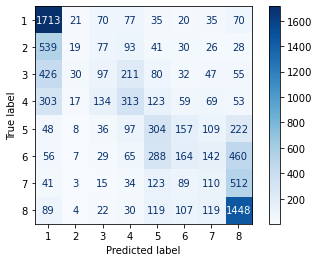

In [62]:
plot_confusion_matrix(model_sgd, X_test_tfidf, y_test_tfidf, cmap=plt.cm.Blues)
pass

In [71]:
from sklearn.linear_model import LogisticRegression

clf = LogisticRegression(max_iter=5000)
model_regr = clf.fit(X_train_tfidf, y_train_tfidf)
y_test_tfidf_pred_regr = model_regr.predict(X_test_tfidf)
accuracy_score(y_test_tfidf, y_test_tfidf_pred_regr)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:593: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:593: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  warnings.warn(


0.4246

In [72]:
print(classification_report(y_test_tfidf, y_test_tfidf_pred_regr))

              precision    recall  f1-score   support

           1       0.56      0.78      0.66      2041
           2       0.22      0.10      0.13       853
           3       0.23      0.15      0.18       978
           4       0.33      0.33      0.33      1071
           5       0.30      0.25      0.27       981
           6       0.28      0.24      0.26      1211
           7       0.24      0.09      0.13       927
           8       0.50      0.75      0.60      1938

    accuracy                           0.42     10000
   macro avg       0.33      0.34      0.32     10000
weighted avg       0.37      0.42      0.38     10000



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:593: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  warnings.warn(


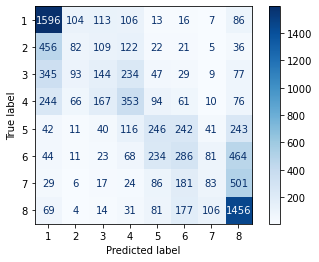

In [73]:
plot_confusion_matrix(model_regr, X_test_tfidf, y_test_tfidf, cmap=plt.cm.Blues)
pass

### 3. Обучение на предобработанном тексте, CNN, LSTM, GRU

### 3.1. Регрессия
Обучаем классификатор для получения численного значения тональности, например от 1 до 10, где большее значение означает более положительную тональность.

#### Векторизуем тексты с помощью Embedding

In [74]:
from gensim.models import Word2Vec

proc_words = [preproc_nltk(text).split() for text in df.text]
embeddings_trained = Word2Vec(proc_words, # data for model to train on
                 vector_size=100,                 # embedding vector size
                 min_count=3,             # consider words that occured at least 5 times
                 window=3).wv

In [75]:
def vectorize_sum(comment, embeddings):
    """
    implement a function that converts preprocessed comment to a sum of token vectors
    """
    embedding_dim = embeddings.vectors.shape[1]
    features = np.zeros([embedding_dim], dtype='float32')

    for word in preproc_nltk(comment).split():
        if word in embeddings:
            features += embeddings[f'{word}']
    
    return features

#### Обучение на embedding

In [76]:
X_wv = np.stack([vectorize_sum(text, embeddings_trained) for text in df.text])
X_train_wv, X_test_wv, y_train_wv, y_test_wv = train_test_split(X_wv, df.rating, test_size=0.2, random_state=0)
X_train_wv.shape, X_test_wv.shape

((40000, 100), (10000, 100))

In [77]:
clf_emb = LogisticRegression(max_iter=5000)
model_regr_emb = clf_emb.fit(X_train_wv, y_train_wv)
y_test_pred_wv = model_regr_emb.predict(X_test_wv)
accuracy_score(y_test_wv, y_test_pred_wv)

0.4173

In [78]:
df.rating

0        2
1        5
2        3
3        2
4        7
        ..
49995    1
49996    5
49997    8
49998    5
49999    1
Name: rating, Length: 50000, dtype: int32

In [79]:
print(classification_report(y_test_wv, y_test_pred_wv))

              precision    recall  f1-score   support

           1       0.52      0.83      0.64      2041
           2       0.22      0.03      0.05       853
           3       0.24      0.09      0.13       978
           4       0.31      0.33      0.32      1071
           5       0.30      0.21      0.24       981
           6       0.32      0.19      0.24      1211
           7       0.29      0.03      0.05       927
           8       0.43      0.80      0.56      1938

    accuracy                           0.42     10000
   macro avg       0.33      0.31      0.28     10000
weighted avg       0.36      0.42      0.35     10000



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


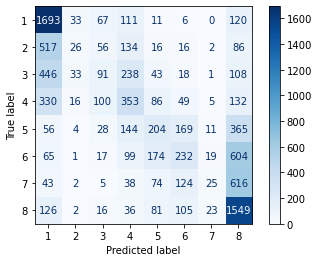

In [80]:
plot_confusion_matrix(model_regr_emb, X_test_wv, y_test_wv, cmap=plt.cm.Blues)
pass

### Токенизация, обучение

In [40]:
# Максимальное количество слов
max_num = 10000

# Максимальная длина отзыва
max_comm_len = 300

#Количество классов отзывов
num_classes = 8

#Уменьшим оценивание на 1, т.к. так удобнее для представления данных (чтобы нумерация начиналась с 0)

In [41]:
df_proc = pd.DataFrame(data=new_texts, columns=['text'])

Токенизация текста

In [42]:
df_proc.text[:5]

0    I one absolutely love movie   not typical asia...
1    I see like first two lot really especially sec...
2    well basically movie blow ! Blair Witch meet S...
3    funny thing happen sitcom base main character ...
4    I catch movie Horror Channel quite impressed f...
Name: text, dtype: object

Создаём токенизатор Keras

In [43]:
tokenizer = Tokenizer(num_words=max_num)

Обучаем токенизатор (только на обучающих данных)

In [44]:
from sklearn.model_selection import train_test_split
X_tr, X_ts, y_train, y_test = train_test_split(df_proc.text, df.rating, test_size=0.2, random_state=0)

In [45]:
tokenizer.fit_on_texts(X_tr)

Просматриваем словарь токенизатора. Токенизатор заменяет слова на соответствующие им числа (которые говорят о частоте появления слова в документах)

In [46]:
tokenizer.word_index

{'i': 1,
 'not': 2,
 'movie': 3,
 'film': 4,
 'one': 5,
 'see': 6,
 'make': 7,
 'like': 8,
 'good': 9,
 'get': 10,
 'well': 11,
 'time': 12,
 'character': 13,
 'watch': 14,
 'go': 15,
 'would': 16,
 'bad': 17,
 'even': 18,
 'story': 19,
 'no': 20,
 'think': 21,
 'really': 22,
 'show': 23,
 'scene': 24,
 'great': 25,
 'look': 26,
 'much': 27,
 'say': 28,
 'know': 29,
 'could': 30,
 'people': 31,
 'also': 32,
 'give': 33,
 'first': 34,
 'take': 35,
 'way': 36,
 'play': 37,
 'love': 38,
 'thing': 39,
 'come': 40,
 'find': 41,
 'end': 42,
 'seem': 43,
 'man': 44,
 'life': 45,
 'work': 46,
 'many': 47,
 'plot': 48,
 'two': 49,
 'actor': 50,
 'want': 51,
 'never': 52,
 'try': 53,
 'year': 54,
 'little': 55,
 'ever': 56,
 'still': 57,
 'feel': 58,
 'part': 59,
 'something': 60,
 'use': 61,
 'lot': 62,
 'act': 63,
 'back': 64,
 'old': 65,
 'director': 66,
 'real': 67,
 'guy': 68,
 'funny': 69,
 'performance': 70,
 'another': 71,
 'though': 72,
 'actually': 73,
 'woman': 74,
 'big': 75,
 'role'

Преобразуем текстовое представление в числовое

In [47]:
sequences = tokenizer.texts_to_sequences(X_tr)

Просмотрим отзывы в числовом представлении

In [48]:
index = 0
print(X_tr[index])
print(sequences[index])

I one absolutely love movie   not typical asian horror would see gruesome look ghost usually woman go around scare people barely see ghost majority film way movie keep interested plot character genius not movie gore eg Saw Hostel surprise scare stuff pop Hollywood horror slasher film movie underlie creepy factor throughout entire movie I love Noroi progressive somewhat experimental approach horror amongst ridiculous remake unoriginal crap release Hollywood today society   please not let documentarystyle film turn ! far superior Blair Witch Project one acting Noroi brilliant really make really feel like watch something not suppose see   Noroi definitely one good horror movie I ever see film make Top   horror movie hold solid   spot list
[1, 28, 269, 285, 1071, 1, 28, 3289, 859, 272, 604, 56, 192, 3428, 1, 905, 382, 87, 1, 220, 126, 1331, 509, 3289, 454, 1, 333, 978, 2768, 49, 214, 45, 514, 1018, 9305, 491, 204, 3, 109, 9169, 12, 2072, 1650, 601, 342, 502, 2701, 109, 666, 564, 296, 239, 

In [49]:
tokenizer.word_index['nicely']

1499

Ограничиваем длину отзывов (т.к. данные на вход должны быть одинаковой длины)

In [50]:
X_train = pad_sequences(sequences, maxlen = max_comm_len)

In [51]:
X_train[:5]

array([[   0,    0,    0, ...,  129,    1,  192],
       [   0,    0,    0, ..., 1699,   31,    3],
       [   0,    0,    0, ...,  250,   11, 6170],
       [   0,    0,    0, ...,    2,  728, 5912],
       [   0,    0,    0, ...,   45,   64, 1907]])

Аналогично для тестовой выборки

In [52]:
test_sequences = tokenizer.texts_to_sequences(X_ts)

In [53]:
X_test = pad_sequences(test_sequences, maxlen = max_comm_len)

In [54]:
X_test[:5]

array([[   0,    0,    0, ...,  416, 2068,  685],
       [   0,    0,    0, ..., 2421,   94, 6723],
       [   0,    0,    0, ..., 3037,   40,  191],
       [   0,    0,    0, ...,  618, 2215,    1],
       [   0,    0,    0, ...,  223,   98,  340]])

### 3.2. Плоская классификация
Плоская классификация — обучаем лишь один классификатор для всех классов;

In [112]:
y_train_flat = utils.to_categorical(y_train-1, num_classes)

- Одномерная сверточная нейросеть
- Рекуррентная нейросеть LSTM
- Рекуррентная нейросеть GRU

In [113]:
y_test_flat = utils.to_categorical(y_test-1, num_classes)

#### 3.2.1. CNN 

In [114]:
model_cnn = Sequential()
model_cnn.add(Embedding(max_num, 100, input_length = max_comm_len))
model_cnn.add(Conv1D(250, 5, padding = 'valid', activation = 'relu'))
model_cnn.add(GlobalMaxPooling1D())
model_cnn.add(Dense(128, activation = 'relu'))
model_cnn.add(Dense(8, activation = 'softmax'))

In [115]:
model_cnn.compile(optimizer = 'adam',
                 loss = 'categorical_crossentropy',
                 metrics=['accuracy'])

In [116]:
model_cnn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 300, 100)          1000000   
                                                                 
 conv1d (Conv1D)             (None, 296, 250)          125250    
                                                                 
 global_max_pooling1d (Globa  (None, 250)              0         
 lMaxPooling1D)                                                  
                                                                 
 dense (Dense)               (None, 128)               32128     
                                                                 
 dense_1 (Dense)             (None, 8)                 1032      
                                                                 
Total params: 1,158,410
Trainable params: 1,158,410
Non-trainable params: 0
______________________________________________

Создадим callback для сохранения лучшей модели, которую покажет нейронная сеть

In [117]:
model_cnn_save_path = 'best_model_cnn.h5'
checkpoint_callback_cnn = ModelCheckpoint(model_cnn_save_path,
                                         monitor = 'val_accuracy',
                                         save_best_only = True,
                                         verbose = 1)

In [119]:
history_cnn = model_cnn.fit(X_train, y_train_flat,
                           epochs = 3,
                           batch_size = 128,
                           validation_split = 0.1,
                           callbacks = [checkpoint_callback_cnn])

Epoch 1/3
282/282 [==============================] - ETA: 0s - loss: 1.6321 - accuracy: 0.3757
Epoch 1: val_accuracy improved from -inf to 0.41400, saving model to best_model_cnn.h5
282/282 [==============================] - 145s 513ms/step - loss: 1.6321 - accuracy: 0.3757 - val_loss: 1.4995 - val_accuracy: 0.4140
Epoch 2/3
282/282 [==============================] - ETA: 0s - loss: 1.3371 - accuracy: 0.4668
Epoch 2: val_accuracy improved from 0.41400 to 0.41875, saving model to best_model_cnn.h5
282/282 [==============================] - 154s 545ms/step - loss: 1.3371 - accuracy: 0.4668 - val_loss: 1.4733 - val_accuracy: 0.4187
Epoch 3/3
282/282 [==============================] - ETA: 0s - loss: 1.1397 - accuracy: 0.5375
Epoch 3: val_accuracy did not improve from 0.41875
282/282 [==============================] - 157s 557ms/step - loss: 1.1397 - accuracy: 0.5375 - val_loss: 1.5773 - val_accuracy: 0.3925


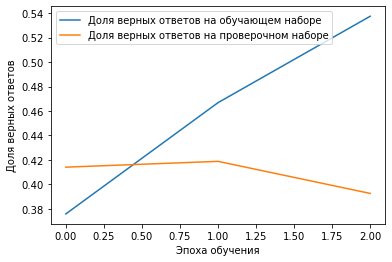

In [120]:
plt.plot(history_cnn.history['accuracy'],
        label = 'Доля верных ответов на обучающем наборе')
plt.plot(history_cnn.history['val_accuracy'],
        label = 'Доля верных ответов на проверочном наборе')
plt.xlabel('Эпоха обучения')
plt.ylabel('Доля верных ответов')
plt.legend()
plt.show()

In [121]:
model_cnn.load_weights(model_cnn_save_path)

In [122]:
model_cnn.evaluate(X_test, y_test_flat, verbose = 1)

313/313 [==============================] - 14s 45ms/step - loss: 1.4402 - accuracy: 0.4384


[1.4401929378509521, 0.438400000333786]

In [123]:
y_test_pred_cnn = model_cnn.predict(X_test)
#accuracy_score(y_test_flat, y_test_pred_cnn)

In [124]:
#print(classification_report(y_test_flat, y_test_pred_cnn))

In [125]:
#plot_confusion_matrix(model_cnn, X_test, y_test_flat, cmap=plt.cm.Blues)
#pass

#### 3.2.2. Сеть LSTM

In [126]:
model_lstm = Sequential()
model_lstm.add(Embedding(max_num, 200, input_length = max_comm_len))
model_lstm.add(LSTM(128, return_sequences = True))
model_lstm.add(LSTM(64))
model_lstm.add(Dense(8, activation = 'softmax'))

In [127]:
model_lstm.compile(optimizer = 'adam',
                 loss = 'categorical_crossentropy',
                 metrics=['accuracy'])

In [128]:
model_lstm_save_path = 'best_model_lstm.h5'
checkpoint_callback_lstm = ModelCheckpoint(model_lstm_save_path,
                                         monitor = 'val_accuracy',
                                         save_best_only = True,
                                         verbose = 1)

In [129]:
history_lstm = model_lstm.fit(X_train, y_train_flat,
                           epochs = 2,
                           batch_size = 128,
                           validation_split = 0.1,
                           callbacks = [checkpoint_callback_lstm])

Epoch 1/2
 22/282 [=>............................] - ETA: 19:14 - loss: 2.0309 - accuracy: 0.2290

KeyboardInterrupt: 

In [ ]:
plt.plot(history_lstm.history['accuracy'],
        label = 'Доля верных ответов на обучающем наборе')
plt.plot(history_lstm.history['val_accuracy'],
        label = 'Доля верных ответов на проверочном наборе')
plt.xlabel('Эпоха обучения')
plt.ylabel('Доля верных ответов')
plt.legend()
plt.show()

In [ ]:
model_lstm.load_weights(model_lstm_save_path)

In [ ]:
model_lstm.evaluate(X_test, y_test_flat, verbose = 1)

In [ ]:
#y_test_pred_lstm = model_lstm.predict(X_test)
#accuracy_score(y_test_flat, y_test_pred_lstm)

In [ ]:
#print(classification_report(y_test_flat, y_test_pred_lstm))

In [ ]:
#plot_confusion_matrix(model_lstm, X_test, y_test_flat, cmap=plt.cm.Blues)
#pass

#### 3.2.3. Сеть GRU

In [145]:
model_gru = Sequential()
model_gru.add(Embedding(max_num, 32, input_length = max_comm_len))
model_gru.add(GRU(128))
model_gru.add(Dense(8, activation = 'softmax'))

In [146]:
model_gru.compile(optimizer = 'adam',
                 loss = 'categorical_crossentropy',
                 metrics=['accuracy'])

In [147]:
model_gru_save_path = 'best_model_gru.h5'
checkpoint_callback_gru = ModelCheckpoint(model_gru_save_path,
                                         monitor = 'val_accuracy',
                                         save_best_only = True,
                                         verbose = 1)

In [148]:
history_gru = model_gru.fit(X_train, y_train_flat,
                           epochs = 5,
                           batch_size = 128,
                           validation_split = 0.1,
                           callbacks = [checkpoint_callback_gru])

Epoch 1/5
282/282 [==============================] - ETA: 0s - loss: 1.8459 - accuracy: 0.2950
Epoch 1: val_accuracy improved from -inf to 0.38325, saving model to best_model_gru.h5
282/282 [==============================] - 195s 685ms/step - loss: 1.8459 - accuracy: 0.2950 - val_loss: 1.5700 - val_accuracy: 0.3832
Epoch 2/5
282/282 [==============================] - ETA: 0s - loss: 1.4661 - accuracy: 0.4265
Epoch 2: val_accuracy improved from 0.38325 to 0.42650, saving model to best_model_gru.h5
282/282 [==============================] - 201s 713ms/step - loss: 1.4661 - accuracy: 0.4265 - val_loss: 1.4783 - val_accuracy: 0.4265
Epoch 3/5
282/282 [==============================] - ETA: 0s - loss: 1.3333 - accuracy: 0.4709
Epoch 3: val_accuracy did not improve from 0.42650
282/282 [==============================] - 201s 713ms/step - loss: 1.3333 - accuracy: 0.4709 - val_loss: 1.4615 - val_accuracy: 0.4248
Epoch 4/5
282/282 [==============================] - ETA: 0s - loss: 1.2574 - accu

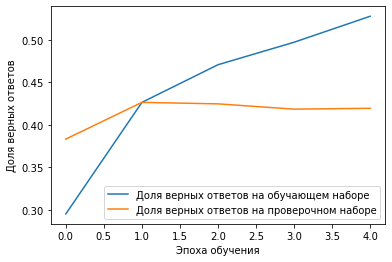

In [149]:
plt.plot(history_gru.history['accuracy'],
        label = 'Доля верных ответов на обучающем наборе')
plt.plot(history_gru.history['val_accuracy'],
        label = 'Доля верных ответов на проверочном наборе')
plt.xlabel('Эпоха обучения')
plt.ylabel('Доля верных ответов')
plt.legend()
plt.show()

In [150]:
model_gru.load_weights(model_gru_save_path)

In [151]:
model_gru.evaluate(X_test, y_test_flat, verbose = 1)

313/313 [==============================] - 21s 66ms/step - loss: 1.4919 - accuracy: 0.4312


[1.4918934106826782, 0.4311999976634979]

In [ ]:
#y_test_pred_gru = model_gru.predict(X_test)
#accuracy_score(y_test_flat, y_test_pred_gru)

In [ ]:
#print(classification_report(y_test_flat, y_test_pred_gru))

In [ ]:
#plot_confusion_matrix(model_gru, X_test, y_test_flat, cmap=plt.cm.Blues)
#pass

## 3.3. Иерархическая классификация

Делим классы на группы и обучаем несколько классификаторов для определения групп. Например, если у нас 8 классов, то можно сначала обучить бинарный классификатор, который отделяет положительные мнения от отрицательных; а затем ещё два классификатора, которые будут отделять сильно выраженные мнения от более слабо выраженных;

### 1. Положительные и отрицательные
#### LSTM

In [55]:
y_train_bin = y_train.copy()

#y_train_bin[y_train_bin < 5] = 0
#y_train_bin[y_train_bin >= 5] = 1

y_train_bin = y_train_bin.to_numpy()
y_train_bin

array([7, 1, 3, ..., 6, 4, 5])

In [56]:
index_train_1 = np.where (y_train_bin == 1)[0]
index_train_2 = np.where (y_train_bin == 2)[0]
index_train_3 = np.where (y_train_bin == 3)[0]
index_train_4 = np.where (y_train_bin == 4)[0]
index_train_5 = np.where (y_train_bin == 5)[0]
index_train_6 = np.where (y_train_bin == 6)[0]
index_train_7 = np.where (y_train_bin == 7)[0]
index_train_8 = np.where (y_train_bin == 8)[0]
index_train_8

array([    5,    13,    17, ..., 39975, 39977, 39981], dtype=int64)

In [57]:
index_train_12 = np.sort((np.concatenate((index_train_1, index_train_2), axis = None)), axis=None)
print(index_train_1)
print(index_train_2)
print(index_train_12)

index_train_34 = np.sort(np.concatenate((index_train_3, index_train_4), axis = None), axis = None)
index_train_56 = np.sort(np.concatenate((index_train_5, index_train_6), axis = None), axis = None)
index_train_78 = np.sort(np.concatenate((index_train_7, index_train_8), axis = None), axis = None)

index_train_neg = np.sort(np.concatenate((index_train_12, index_train_34), axis = None), axis = None)
index_train_pos = np.sort(np.concatenate((index_train_56, index_train_78), axis = None), axis = None)

[    1     3     4 ... 39972 39982 39995]
[   10    12    16 ... 39961 39963 39978]
[    1     3     4 ... 39978 39982 39995]


In [58]:
y_train_bin[y_train_bin <5 ] = 0
y_train_bin[y_train_bin >= 5 ] = 1
y_train_bin

array([1, 0, 0, ..., 1, 0, 1])

In [59]:
y_test_bin = y_test.copy()

y_test_bin = y_test_bin.to_numpy()

index_test_1 = np.where (y_test_bin == 1)[0]
index_test_2 = np.where (y_test_bin == 2)[0]
index_test_3 = np.where (y_test_bin == 3)[0]
index_test_4 = np.where (y_test_bin == 4)[0]
index_test_5 = np.where (y_test_bin == 5)[0]
index_test_6 = np.where (y_test_bin == 6)[0]
index_test_7 = np.where (y_test_bin == 7)[0]
index_test_8 = np.where (y_test_bin == 8)[0]

y_test_bin[y_test_bin < 5] = 0
y_test_bin[y_test_bin >= 5] = 1

y_test_bin

array([1, 1, 1, ..., 0, 0, 0])

In [60]:
index_test_12 = np.concatenate((index_test_1, index_test_2), axis = None)
index_test_34 = np.concatenate((index_test_3, index_test_4), axis = None)
index_test_56 = np.concatenate((index_test_5, index_test_6), axis = None)
index_test_78 = np.concatenate((index_test_7, index_test_8), axis = None)

index_test_neg = np.sort(np.concatenate((index_test_12, index_test_34), axis = None), axis = None)
index_test_pos = np.sort(np.concatenate((index_test_56, index_test_78), axis = None), axis = None)

In [61]:
model_1 = Sequential()
model_1.add(Embedding(max_num, 64, input_length=max_comm_len))
model_1.add(LSTM(128))
model_1.add(Dense(1, activation='sigmoid'))

In [62]:
model_1.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

In [63]:
model_1_save_path = 'best_model_1.h5'
checkpoint_callback_1 = ModelCheckpoint(model_1_save_path, 
                                        monitor='val_accuracy',
                                        save_best_only=True,
                                        verbose=1)

In [64]:
history_1 = model_1.fit(X_train, 
                    y_train_bin, 
                    epochs=3,
                    batch_size=128,
                    validation_split=0.1,
                    callbacks=[checkpoint_callback_1])

Epoch 1/3
282/282 [==============================] - ETA: 0s - loss: 0.4207 - accuracy: 0.8092
Epoch 1: val_accuracy improved from -inf to 0.88950, saving model to best_model_1.h5
282/282 [==============================] - 775s 3s/step - loss: 0.4207 - accuracy: 0.8092 - val_loss: 0.2764 - val_accuracy: 0.8895
Epoch 2/3
282/282 [==============================] - ETA: 0s - loss: 0.2330 - accuracy: 0.9100
Epoch 2: val_accuracy improved from 0.88950 to 0.89950, saving model to best_model_1.h5
282/282 [==============================] - 979s 3s/step - loss: 0.2330 - accuracy: 0.9100 - val_loss: 0.2606 - val_accuracy: 0.8995
Epoch 3/3
282/282 [==============================] - ETA: 0s - loss: 0.1864 - accuracy: 0.9307
Epoch 3: val_accuracy did not improve from 0.89950
282/282 [==============================] - 1010s 4s/step - loss: 0.1864 - accuracy: 0.9307 - val_loss: 0.2947 - val_accuracy: 0.8923


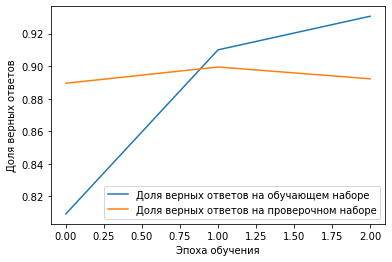

In [65]:
plt.plot(history_1.history['accuracy'], 
         label='Доля верных ответов на обучающем наборе')
plt.plot(history_1.history['val_accuracy'], 
         label='Доля верных ответов на проверочном наборе')
plt.xlabel('Эпоха обучения')
plt.ylabel('Доля верных ответов')
plt.legend()
plt.show()

In [66]:
model_1.load_weights(model_1_save_path)

In [67]:
y_test_pred_1_lstm = model_1.predict(X_test)

In [68]:
y_test_pred_1_lstm[y_test_pred_1_lstm <= 0.5] = 0
y_test_pred_1_lstm[y_test_pred_1_lstm > 0.5] = 1

In [73]:
accuracy_score(y_test_bin, y_test_pred_1_lstm)

0.8867

In [74]:
print(classification_report(y_test_bin, y_test_pred_1_lstm))

              precision    recall  f1-score   support

           0       0.91      0.86      0.88      5032
           1       0.87      0.91      0.89      4968

    accuracy                           0.89     10000
   macro avg       0.89      0.89      0.89     10000
weighted avg       0.89      0.89      0.89     10000



In [75]:
#plot_confusion_matrix(model_1, X_test, y_test_bin, cmap=plt.cm.Blues)
#pass

#### GRU

In [80]:
model_2 = Sequential()
model_2.add(Embedding(max_num, 64, input_length=max_comm_len))
model_2.add(GRU(128))
model_2.add(Dense(1, activation='sigmoid'))

In [81]:
model_2.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

In [82]:
model_2_save_path = 'best_model_2.h5'
checkpoint_callback_2 = ModelCheckpoint(model_2_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

In [83]:
history_2 = model_2.fit(X_train, 
                    y_train_bin, 
                    epochs=3,
                    batch_size=128,
                    validation_split=0.1,
                    callbacks=[checkpoint_callback_2])

Epoch 1/3
282/282 [==============================] - ETA: 0s - loss: 0.3823 - accuracy: 0.8180
Epoch 1: val_accuracy improved from -inf to 0.88600, saving model to best_model_2.h5
282/282 [==============================] - 947s 3s/step - loss: 0.3823 - accuracy: 0.8180 - val_loss: 0.2712 - val_accuracy: 0.8860
Epoch 2/3
282/282 [==============================] - ETA: 0s - loss: 0.2281 - accuracy: 0.9122
Epoch 2: val_accuracy improved from 0.88600 to 0.88825, saving model to best_model_2.h5
282/282 [==============================] - 992s 4s/step - loss: 0.2281 - accuracy: 0.9122 - val_loss: 0.2705 - val_accuracy: 0.8882
Epoch 3/3
282/282 [==============================] - ETA: 0s - loss: 0.1838 - accuracy: 0.9309
Epoch 3: val_accuracy improved from 0.88825 to 0.89350, saving model to best_model_2.h5
282/282 [==============================] - 997s 4s/step - loss: 0.1838 - accuracy: 0.9309 - val_loss: 0.2657 - val_accuracy: 0.8935


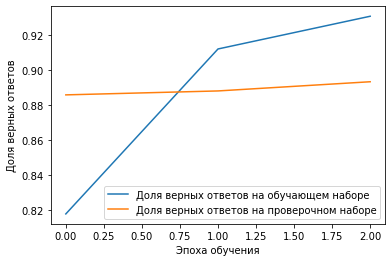

In [84]:
plt.plot(history_2.history['accuracy'], 
         label='Доля верных ответов на обучающем наборе')
plt.plot(history_2.history['val_accuracy'], 
         label='Доля верных ответов на проверочном наборе')
plt.xlabel('Эпоха обучения')
plt.ylabel('Доля верных ответов')
plt.legend()
plt.show()

In [85]:
model_2.load_weights(model_2_save_path)
y_test_pred_2_gru = model_2.predict(X_test)

Если значение < 0.5, то отзыв отрицательный, если >=0.5, то отзыв положительный

In [86]:
y_test_pred_2_gru[y_test_pred_2_gru <= 0.5] = 0
y_test_pred_2_gru[y_test_pred_2_gru > 0.5] = 1

In [87]:
accuracy_score(y_test_bin, y_test_pred_2_gru)

0.88

#### 12 и 34, 56 и 78

In [95]:
#y_train = df_train.rating
#y_train_12 = y_train[y_train <= 2]

#y_train_34 = y_train[y_train <= 4]
#y_train_34 = y_train_34[y_train_34 > 2]

#y_train_56 = y_train[4 < y_train]
#y_train_56 = y_train_56[y_train_56 <= 6]

#y_train_78 = y_train[y_train > 6]

#y_train_78

In [96]:
y_train_neg = y_train.copy()[y_train<=4]
y_train_neg = y_train_neg.to_numpy()
y_train_neg[y_train_neg<=2] = 0
y_train_neg[y_train_neg>=3] = 1

y_train_pos = y_train[y_train > 4].copy()
y_train_pos = y_train_pos.to_numpy()
y_train_pos[y_train_pos<=6] = 0
y_train_pos[y_train_pos>6] = 1
y_train_neg

array([0, 1, 0, ..., 1, 0, 1])

In [97]:
X_train_neg = X_train[index_train_neg]
X_train_pos = X_train[index_train_pos]
y_train_neg.shape

(19968,)

In [98]:
model_21 = Sequential()
model_21.add(Embedding(max_num, 64, input_length=max_comm_len))
model_21.add(GRU(128, return_sequences=True,))
model_21.add(GRU(128))
model_21.add(Dense(1, activation='sigmoid'))

In [99]:
model_21.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

In [100]:
model_21_save_path = 'best_model_21.h5'
checkpoint_callback_21 = ModelCheckpoint(model_21_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

In [101]:
history_21 = model_21.fit(X_train_neg, 
                    y_train_neg, 
                    epochs=3,
                    batch_size=128,
                    validation_split=0.1,
                    callbacks=[checkpoint_callback_21])

Epoch 1/3
141/141 [==============================] - ETA: 0s - loss: 0.6288 - accuracy: 0.6380 
Epoch 1: val_accuracy improved from -inf to 0.70506, saving model to best_model_21.h5
141/141 [==============================] - 1434s 10s/step - loss: 0.6288 - accuracy: 0.6380 - val_loss: 0.5583 - val_accuracy: 0.7051
Epoch 2/3
141/141 [==============================] - ETA: 0s - loss: 0.5368 - accuracy: 0.7321 
Epoch 2: val_accuracy did not improve from 0.70506
141/141 [==============================] - 1859s 13s/step - loss: 0.5368 - accuracy: 0.7321 - val_loss: 0.5921 - val_accuracy: 0.6990
Epoch 3/3
 41/141 [=======>......................] - ETA: 23:50 - loss: 0.4419 - accuracy: 0.7997

KeyboardInterrupt: 

In [102]:
#scores = model.evaluate(X_test, y_test_bin, verbose=1)

In [103]:
#x = model.predict(X_train)

In [104]:
X_test_neg = X_test[index_test_neg]
X_test_pos = X_test[index_test_pos]

In [105]:
y_test_neg = y_test.copy()[y_test<=4]
y_test_neg = y_test_neg.to_numpy()
y_test_neg[y_test_neg<=2] = 0
y_test_neg[y_test_neg>=3] = 1

y_test_pos = y_test[y_test > 4].copy()
y_test_pos = y_test_pos.to_numpy()
y_test_pos[y_test_pos<=6] = 0
y_test_pos[y_test_pos>6] = 1

In [106]:
model_21.load_weights(model_21_save_path)

In [107]:
y_test_pred_21 = model_21.predict(X_test_neg)

Если значение < 0.5, то отзыв 1 или 2, если >=0.5, то отзыв 3 или 4

In [108]:
y_test_pred_21[y_test_pred_21 <= 0.5] = 0
y_test_pred_21[y_test_pred_21 > 0.5] = 1

In [109]:
accuracy_score(y_test_neg, y_test_pred_21)

0.7052861685214626

In [110]:
print(classification_report(y_test_neg, y_test_pred_21))

              precision    recall  f1-score   support

           0       0.76      0.74      0.75      2986
           1       0.63      0.65      0.64      2046

    accuracy                           0.71      5032
   macro avg       0.70      0.70      0.70      5032
weighted avg       0.71      0.71      0.71      5032



In [111]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

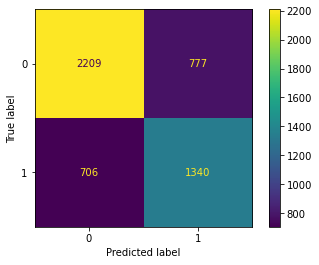

In [112]:
cm_21 = confusion_matrix(y_test_neg, y_test_pred_21)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_21)
disp.plot()

In [113]:
model_22 = Sequential()
model_22.add(Embedding(max_num, 64, input_length=max_comm_len))
model_22.add(GRU(128, return_sequences=True,))
model_22.add(GRU(128))
model_22.add(Dense(1, activation='sigmoid'))

In [114]:
model_22.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

In [115]:
model_22_save_path = 'best_model_22.h5'
checkpoint_callback_22 = ModelCheckpoint(model_22_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

In [116]:
history_22 = model_22.fit(X_train_pos, 
                    y_train_pos, 
                    epochs=3,
                    batch_size=128,
                    validation_split=0.1,
                    callbacks=[checkpoint_callback_22])

Epoch 1/3
141/141 [==============================] - ETA: 0s - loss: 0.6427 - accuracy: 0.6260 
Epoch 1: val_accuracy improved from -inf to 0.67814, saving model to best_model_22.h5
141/141 [==============================] - 1888s 13s/step - loss: 0.6427 - accuracy: 0.6260 - val_loss: 0.6032 - val_accuracy: 0.6781
Epoch 2/3
141/141 [==============================] - ETA: 0s - loss: 0.5328 - accuracy: 0.7357 
Epoch 2: val_accuracy did not improve from 0.67814
141/141 [==============================] - 1789s 13s/step - loss: 0.5328 - accuracy: 0.7357 - val_loss: 0.6207 - val_accuracy: 0.6617
Epoch 3/3
 26/141 [====>.........................] - ETA: 24:03 - loss: 0.4124 - accuracy: 0.8191

KeyboardInterrupt: 

In [117]:
#scores = model.evaluate(X_test, y_test_bin, verbose=1)

In [118]:
model_22.load_weights(model_22_save_path)

In [119]:
y_test_pred_22 = model_22.predict(X_test_pos)

Если значение < 0.5, то отзыв 5 или 6, если >=0.5, то отзыв 7 или 8

In [120]:
y_test_pred_22[y_test_pred_22 <= 0.5] = 0
y_test_pred_22[y_test_pred_22 > 0.5] = 1

In [121]:
accuracy_score(y_test_pos, y_test_pred_22)

0.6930354267310789

In [122]:
print(classification_report(y_test_pos, y_test_pred_22))

              precision    recall  f1-score   support

           0       0.67      0.54      0.60      2105
           1       0.70      0.80      0.75      2863

    accuracy                           0.69      4968
   macro avg       0.69      0.67      0.68      4968
weighted avg       0.69      0.69      0.69      4968



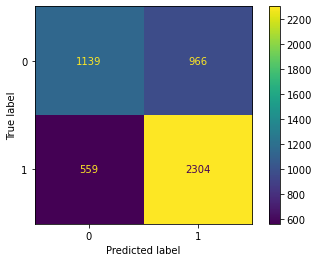

In [123]:
cm_22 = confusion_matrix(y_test_pos, y_test_pred_22)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_22)
disp.plot()

#### 1 и 2 / 3 и 4 / 5 и 6 / 7 и 8

In [124]:
y_train_12 = y_train.copy()[y_train <= 2]
y_train_12 = y_train_12.to_numpy()
y_train_12[y_train_12 == 1] = 0
y_train_12[y_train_12 == 2] = 1


y_train_34 = y_train.copy()[y_train <= 4]
y_train_34 = y_train_34.to_numpy()
y_train_34 = y_train_34[y_train_34 > 2]
y_train_34[y_train_34 == 3] = 0
y_train_34[y_train_34 == 4] = 1

y_train_56 = y_train.copy()[4 < y_train]
y_train_56 = y_train_56.to_numpy()
y_train_56 = y_train_56[y_train_56 <= 6]
y_train_56[y_train_56 == 5] = 0
y_train_56[y_train_56 == 6] = 1


y_train_78 = y_train.copy()[y_train > 6]
y_train_78 = y_train_78.to_numpy()
y_train_78[y_train_78 == 7] = 0
y_train_78[y_train_78 == 8] = 1

y_train_78

array([0, 1, 0, ..., 1, 0, 0])

In [125]:
X_train_12 = X_train[index_train_12]
X_train_34 = X_train[index_train_34]
X_train_56 = X_train[index_train_56]
X_train_78 = X_train[index_train_78]

In [126]:
y_test_12 = y_test.copy()[y_test <= 2]
y_test_12 = y_test_12.to_numpy()
y_test_12[y_test_12 == 1] = 0
y_test_12[y_test_12 == 2] = 1


y_test_34 = y_test.copy()[y_test <= 4]
y_test_34 = y_test_34.to_numpy()
y_test_34 = y_test_34[y_test_34 > 2]
y_test_34[y_test_34 == 3] = 0
y_test_34[y_test_34 == 4] = 1

y_test_56 = y_test.copy()[4 < y_test]
y_test_56 = y_test_56.to_numpy()
y_test_56 = y_test_56[y_test_56 <= 6]
y_test_56[y_test_56 == 5] = 0
y_test_56[y_test_56 == 6] = 1


y_test_78 = y_test.copy()[y_test > 6]
y_test_78 = y_test_78.to_numpy()
y_test_78[y_test_78 == 7] = 0
y_test_78[y_test_78 == 8] = 1

In [127]:
X_test_12 = X_test[index_test_12]
X_test_34 = X_test[index_test_34]
X_test_56 = X_test[index_test_56]
X_test_78 = X_test[index_test_78]

In [128]:
model_31 = Sequential()
model_31.add(Embedding(max_num, 64, input_length=max_comm_len))
model_31.add(GRU(128, return_sequences=True))
model_31.add(GRU(128))
model_31.add(Dense(1, activation='sigmoid'))

In [129]:
model_31.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

In [130]:
model_31_save_path = 'best_model_31.h5'
checkpoint_callback_31 = ModelCheckpoint(model_31_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

In [131]:
history_31 = model_31.fit(X_train_12, 
                    y_train_12, 
                    epochs=3,
                    batch_size=128,
                    validation_split=0.1,
                    callbacks=[checkpoint_callback_31])

Epoch 1/3
83/83 [==============================] - ETA: 0s - loss: 0.6210 - accuracy: 0.6884
Epoch 1: val_accuracy improved from -inf to 0.67178, saving model to best_model_31.h5
83/83 [==============================] - 732s 9s/step - loss: 0.6210 - accuracy: 0.6884 - val_loss: 0.6324 - val_accuracy: 0.6718
Epoch 2/3
83/83 [==============================] - ETA: 0s - loss: 0.5472 - accuracy: 0.7237
Epoch 2: val_accuracy did not improve from 0.67178
83/83 [==============================] - 747s 9s/step - loss: 0.5472 - accuracy: 0.7237 - val_loss: 0.6540 - val_accuracy: 0.6530
Epoch 3/3
83/83 [==============================] - ETA: 0s - loss: 0.4500 - accuracy: 0.7893
Epoch 3: val_accuracy did not improve from 0.67178
83/83 [==============================] - 754s 9s/step - loss: 0.4500 - accuracy: 0.7893 - val_loss: 0.7601 - val_accuracy: 0.6385


In [132]:
model_31.load_weights(model_31_save_path)

In [133]:
y_test_pred_12 = model_31.predict(X_test_12)

Если значение < 0.5, то отзыв 1, если >=0.5, то отзыв 2

In [134]:
y_test_pred_12[y_test_pred_12 <= 0.5] = 0
y_test_pred_12[y_test_pred_12 > 0.5] = 1

In [135]:
accuracy_score(y_test_12, y_test_pred_12)

0.6885465505693235

In [136]:
print(classification_report(y_test_12, y_test_pred_12))

              precision    recall  f1-score   support

           0       0.69      1.00      0.82      2056
           1       0.00      0.00      0.00       930

    accuracy                           0.69      2986
   macro avg       0.34      0.50      0.41      2986
weighted avg       0.47      0.69      0.56      2986



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


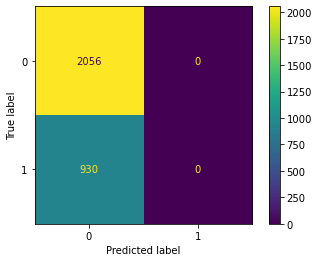

In [137]:
cm_31 = confusion_matrix(y_test_12, y_test_pred_12)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_31)
disp.plot()

In [138]:
model_32 = Sequential()
model_32.add(Embedding(max_num, 64, input_length=max_comm_len))
model_32.add(LSTM(128, return_sequences=True))
model_32.add(LSTM(128))
model_32.add(Dense(1, activation='sigmoid'))

In [139]:
model_32.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

In [140]:
model_32_save_path = 'best_model_32.h5'
checkpoint_callback_32 = ModelCheckpoint(model_32_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

In [141]:
history_32 = model_32.fit(X_train_34, 
                    y_train_34, 
                    epochs=3,
                    batch_size=128,
                    validation_split=0.1,
                    callbacks=[checkpoint_callback_32])

Epoch 1/3
58/58 [==============================] - ETA: 0s - loss: 0.6910 - accuracy: 0.5272 
Epoch 1: val_accuracy improved from -inf to 0.51515, saving model to best_model_32.h5
58/58 [==============================] - 937s 16s/step - loss: 0.6910 - accuracy: 0.5272 - val_loss: 0.6911 - val_accuracy: 0.5152
Epoch 2/3
58/58 [==============================] - ETA: 0s - loss: 0.6103 - accuracy: 0.6668 
Epoch 2: val_accuracy improved from 0.51515 to 0.55758, saving model to best_model_32.h5
58/58 [==============================] - 974s 17s/step - loss: 0.6103 - accuracy: 0.6668 - val_loss: 0.7149 - val_accuracy: 0.5576
Epoch 3/3
58/58 [==============================] - ETA: 0s - loss: 0.4280 - accuracy: 0.8057 
Epoch 3: val_accuracy did not improve from 0.55758
58/58 [==============================] - 1013s 17s/step - loss: 0.4280 - accuracy: 0.8057 - val_loss: 0.8700 - val_accuracy: 0.5576


In [142]:
model_32.load_weights(model_32_save_path)

In [143]:
y_test_pred_34 = model_32.predict(X_test_34)

Если значение < 0.5, то отзыв 3, если >=0.5, то отзыв 4

In [144]:
y_test_pred_34[y_test_pred_34 <= 0.5] = 0
y_test_pred_34[y_test_pred_34 > 0.5] = 1

In [145]:
accuracy_score(y_test_34, y_test_pred_34)

0.4946236559139785

In [146]:
print(classification_report(y_test_34, y_test_pred_34))

              precision    recall  f1-score   support

           0       0.47      0.38      0.42       989
           1       0.51      0.61      0.55      1057

    accuracy                           0.49      2046
   macro avg       0.49      0.49      0.49      2046
weighted avg       0.49      0.49      0.49      2046



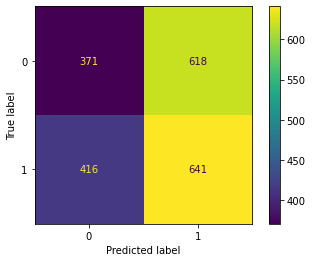

In [147]:
cm_32 = confusion_matrix(y_test_34, y_test_pred_34)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_32)
disp.plot()


In [148]:
model_33 = Sequential()
model_33.add(Embedding(max_num, 64, input_length=max_comm_len))
model_33.add(LSTM(128, return_sequences=True))
model_33.add(LSTM(128))
model_33.add(Dense(1, activation='sigmoid'))

In [149]:
model_33.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

In [150]:
model_33_save_path = 'best_model_33.h5'
checkpoint_callback_33 = ModelCheckpoint(model_33_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

In [151]:
history_33 = model_33.fit(X_train_56, 
                    y_train_56, 
                    epochs=3,
                    batch_size=128,
                    validation_split=0.1,
                    callbacks=[checkpoint_callback_33])

Epoch 1/3
61/61 [==============================] - ETA: 0s - loss: 0.6871 - accuracy: 0.5508 
Epoch 1: val_accuracy improved from -inf to 0.56893, saving model to best_model_33.h5
61/61 [==============================] - 886s 14s/step - loss: 0.6871 - accuracy: 0.5508 - val_loss: 0.6784 - val_accuracy: 0.5689
Epoch 2/3
61/61 [==============================] - ETA: 0s - loss: 0.6018 - accuracy: 0.6767 
Epoch 2: val_accuracy did not improve from 0.56893
61/61 [==============================] - 920s 15s/step - loss: 0.6018 - accuracy: 0.6767 - val_loss: 0.7625 - val_accuracy: 0.5456
Epoch 3/3
61/61 [==============================] - ETA: 0s - loss: 0.4505 - accuracy: 0.7941 
Epoch 3: val_accuracy did not improve from 0.56893
61/61 [==============================] - 944s 15s/step - loss: 0.4505 - accuracy: 0.7941 - val_loss: 0.8676 - val_accuracy: 0.5444


In [152]:
model_33.load_weights(model_33_save_path)

In [153]:
y_test_pred_56 = model_33.predict(X_test_56)

Если значение < 0.5, то отзыв 5, если >=0.5, то отзыв 6

In [154]:
y_test_pred_56[y_test_pred_56 <= 0.5] = 0
y_test_pred_56[y_test_pred_56 > 0.5] = 1

In [155]:
accuracy_score(y_test_56, y_test_pred_56)

0.5258907363420428

In [156]:
print(classification_report(y_test_56, y_test_pred_56))

              precision    recall  f1-score   support

           0       0.45      0.06      0.10       985
           1       0.53      0.94      0.68      1120

    accuracy                           0.53      2105
   macro avg       0.49      0.50      0.39      2105
weighted avg       0.49      0.53      0.41      2105



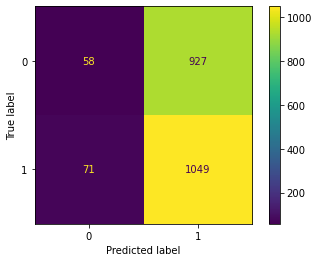

In [158]:
cm_33 = confusion_matrix(y_test_56, y_test_pred_56)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_33)
disp.plot()

In [159]:
model_34 = Sequential()
model_34.add(Embedding(max_num, 64, input_length=max_comm_len))
model_34.add(GRU(128, return_sequences=True,))
model_34.add(GRU(128))
model_34.add(Dense(1, activation='sigmoid'))

In [160]:
model_34.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

In [161]:
model_34_save_path = 'best_model_34.h5'
checkpoint_callback_34 = ModelCheckpoint(model_34_save_path, 
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)

In [162]:
history_34 = model_34.fit(X_train_78, 
                    y_train_78, 
                    epochs=3,
                    batch_size=128,
                    validation_split=0.1,
                    callbacks=[checkpoint_callback_34])

Epoch 1/3
81/81 [==============================] - ETA: 0s - loss: 0.6278 - accuracy: 0.6780
Epoch 1: val_accuracy improved from -inf to 0.65157, saving model to best_model_34.h5
81/81 [==============================] - 686s 8s/step - loss: 0.6278 - accuracy: 0.6780 - val_loss: 0.6417 - val_accuracy: 0.6516
Epoch 2/3
81/81 [==============================] - ETA: 0s - loss: 0.5542 - accuracy: 0.7185
Epoch 2: val_accuracy did not improve from 0.65157
81/81 [==============================] - 703s 9s/step - loss: 0.5542 - accuracy: 0.7185 - val_loss: 0.6697 - val_accuracy: 0.6307
Epoch 3/3
81/81 [==============================] - ETA: 0s - loss: 0.4276 - accuracy: 0.8023
Epoch 3: val_accuracy did not improve from 0.65157
81/81 [==============================] - 705s 9s/step - loss: 0.4276 - accuracy: 0.8023 - val_loss: 0.7633 - val_accuracy: 0.6028


In [163]:
model_34.load_weights(model_34_save_path)

In [164]:
y_test_pred_78 = model_34.predict(X_test_78)

Если значение < 0.5, то отзыв 7, если >=0.5, то отзыв 8

In [165]:
y_test_pred_78[y_test_pred_78 <= 0.5] = 0
y_test_pred_78[y_test_pred_78 > 0.5] = 1

In [166]:
accuracy_score(y_test_78, y_test_pred_78)

0.684247293049249

In [167]:
print(classification_report(y_test_78, y_test_pred_78))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       904
           1       0.68      1.00      0.81      1959

    accuracy                           0.68      2863
   macro avg       0.34      0.50      0.41      2863
weighted avg       0.47      0.68      0.56      2863



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


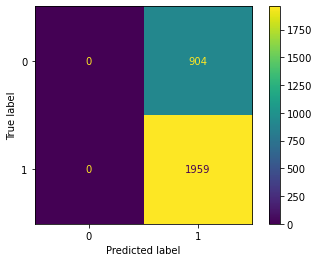

In [168]:
cm_34 = confusion_matrix(y_test_78, y_test_pred_78)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_34)
disp.plot()

## Проверим на тестовой выборке

Иерархическая классификация

In [169]:
N, shape = X_test.shape
y_result = np.zeros(N)
y_result

array([0., 0., 0., ..., 0., 0., 0.])

In [170]:
y_result_1 = model_1.predict(X_test)

In [171]:
y_result_1

array([[0.9902017 ],
       [0.62347317],
       [0.7020696 ],
       ...,
       [0.3409334 ],
       [0.05039838],
       [0.03773594]], dtype=float32)

In [ ]:
#y_result_neg = y_result_1[y_result_1 < 0.5]
#y_result_pos = y_result_1[y_result_1 >= 0.5]

In [172]:
indexes_neg = np.where( y_result_1<0.5 )[0]
indexes_pos = np.where( y_result_1>=0.5 )[0]
print(indexes_neg)

[   8   10   11 ... 9997 9998 9999]


In [173]:
y_result = y_result_1.copy()
y_result[y_result > 0.5] = 5678
y_result[y_result <= 0.5] = 1234
y_result

array([[5678.],
       [5678.],
       [5678.],
       ...,
       [1234.],
       [1234.],
       [1234.]], dtype=float32)

In [174]:
#df_test_pos_neg = df_test.copy()
#df_test_pos_neg.loc[df_test_pos_neg.rating >= 5, 'rating'] = 5678
#df_test_pos_neg.loc[df_test_pos_neg.rating < 5, 'rating'] = 1234##

#y_test_pos_neg = y_test_bin.copy()
#y_test_pos_neg
#y_test
#accuracy_score(y_test_pos_neg, y_result)

In [ ]:
#cm = confusion_matrix(y_test_pos_neg, y_result)
#disp = ConfusionMatrixDisplay(confusion_matrix=cm)
#disp.plot()

In [175]:
y_result_21 = model_21.predict(X_test[indexes_neg])
y_result_22 = model_22.predict(X_test[indexes_pos])

In [176]:
y_result_21

array([[0.3668161 ],
       [0.7358365 ],
       [0.8586235 ],
       ...,
       [0.5293337 ],
       [0.43419313],
       [0.66830105]], dtype=float32)

In [177]:
y_result_22

array([[0.5040542 ],
       [0.67852056],
       [0.33208597],
       ...,
       [0.4363752 ],
       [0.61283696],
       [0.33562452]], dtype=float32)

In [178]:
i=0
for j in indexes_neg:
    if (y_result_21[i] >= 0.5):
        y_result[j] = 34
        i+=1
    else:
        y_result[j] = 12
        i+=1

In [179]:
i=0
for j in indexes_pos:
    if (y_result_22[i] >= 0.5):
        y_result[j] = 78
        i+=1
    else:
        y_result[j] = 56
        i+=1

In [180]:
y_result

array([[78.],
       [78.],
       [56.],
       ...,
       [34.],
       [12.],
       [34.]], dtype=float32)

In [181]:
#y_test_12_34_56_78 = y_test
#y_test_12_34_56_78[y_test_12_34_56_78>6] = 78
#y_test_12_34_56_78[y_test_12_34_56_78 <=6] = 56
#y_test_12_34_56_78[y_test_12_34_56_78<=4] = 34
#y_test_12_34_56_78[y_test_12_34_56_78 <=2] = 12
#accuracy_score(y_test_12_34_56_78, y_result)

In [182]:
#cm = confusion_matrix(y_test_12_34_56_78, y_result)
#disp = ConfusionMatrixDisplay(confusion_matrix=cm)
#disp.plot()

In [183]:
indexes_12 = np.where( y_result == 12 )[0]
indexes_34 = np.where( y_result == 34 )[0]
indexes_56 = np.where( y_result == 56 )[0]
indexes_78 = np.where( y_result == 78 )[0]

In [184]:
#indexes_12 = np.where( y_result_21<0.5 )[0]
#indexes_34 = np.where( y_result_21>=0.5 )[0]
#indexes_56 = np.where( y_result_22<0.5 )[0]
#indexes_78 = np.where( y_result_22>=0.5 )[0]

In [185]:
y_result_31 = model_31.predict(X_test[indexes_12])
y_result_32 = model_32.predict(X_test[indexes_34])
y_result_33 = model_33.predict(X_test[indexes_56])
y_result_34 = model_34.predict(X_test[indexes_78])

In [186]:
i=0
for j in indexes_12:
    if (y_result_31[i] >= 0.5):
        y_result[j] = 2
        i+=1
    else:
        y_result[j] = 1
        i+=1

In [187]:
i=0
for j in indexes_34:
    if (y_result_32[i] >= 0.5):
        y_result[j] = 4
        i+=1
    else:
        y_result[j] = 3
        i+=1

In [188]:
i=0
for j in indexes_56:
    if (y_result_33[i] >= 0.5):
        y_result[j] = 6
        i+=1
    else:
        y_result[j] = 5
        i+=1

In [189]:
i=0
for j in indexes_78:
    if (y_result_34[i] >= 0.5):
        y_result[j] = 8
        i+=1
    else:
        y_result[j] = 7
        i+=1

In [190]:
y_result

array([[8.],
       [8.],
       [6.],
       ...,
       [3.],
       [1.],
       [4.]], dtype=float32)

In [191]:
#y1 = y_result_31[ y_result_31 < 0.5]
#y2 = y_result_31[ y_result_31 >= 0.5]
#y3 = y_result_32[ y_result_32 < 0.5]
#y4 = y_result_32[ y_result_32 >= 0.5]
#y5 = y_result_33[ y_result_33 < 0.5]
#y6 = y_result_33[ y_result_33 >= 0.5]
#y7 = y_result_34[ y_result_34 < 0.5]
#y8 = y_result_34[ y_result_34 >= 0.5]

In [192]:
accuracy_score(y_test, y_result)

0.4176

In [193]:
y_test

11841    6
19602    6
45519    5
25747    7
42642    3
        ..
25091    1
27853    7
47278    2
37020    1
2217     1
Name: rating, Length: 10000, dtype: int32

In [194]:
y_result

array([[8.],
       [8.],
       [6.],
       ...,
       [3.],
       [1.],
       [4.]], dtype=float32)

In [198]:
print(classification_report(y_test, y_result))

              precision    recall  f1-score   support

           1       0.55      0.76      0.64      2056
           2       0.00      0.00      0.00       930
           3       0.24      0.16      0.19       989
           4       0.30      0.36      0.33      1057
           5       0.33      0.06      0.10       985
           6       0.25      0.37      0.30      1120
           7       0.00      0.00      0.00       904
           8       0.47      0.81      0.59      1959

    accuracy                           0.42     10000
   macro avg       0.27      0.32      0.27     10000
weighted avg       0.32      0.42      0.35     10000



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [195]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

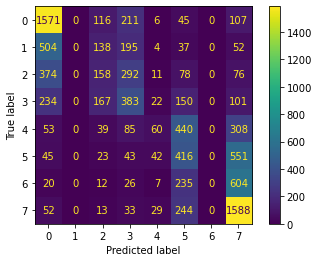

In [197]:
cm = confusion_matrix(y_test, y_result)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

## Сохранение моделей

Сохраним наши модели для передачи на веб-сервис

In [199]:
from tensorflow.keras.models import model_from_json

In [200]:
json_file = 'model_1.json'
model_1_json = model_1.to_json()
with open(json_file, 'w') as f:
    f.write(model_1_json)

In [201]:
with open(json_file, 'r') as f:
    loaded_model = model_from_json(f.read())
    
loaded_model.load_weights('best_model_1.h5')
loaded_model.predict(X_test)

array([[0.9902017 ],
       [0.62347317],
       [0.7020696 ],
       ...,
       [0.3409334 ],
       [0.05039838],
       [0.03773594]], dtype=float32)

In [202]:
json_file = 'model_21.json'
model_21_json = model_21.to_json()

with open(json_file, 'w') as f:
    f.write(model_21_json)

In [203]:
json_file = 'model_22.json'
model_22_json = model_22.to_json()

with open(json_file, 'w') as f:
    f.write(model_22_json)

In [204]:
json_file = 'model_31.json'
model_31_json = model_31.to_json()

with open(json_file, 'w') as f:
    f.write(model_31_json)

In [205]:
json_file = 'model_32.json'
model_32_json = model_32.to_json()

with open(json_file, 'w') as f:
    f.write(model_32_json)

In [206]:
json_file = 'model_33.json'
model_33_json = model_33.to_json()

with open(json_file, 'w') as f:
    f.write(model_33_json)

In [207]:
json_file = 'model_34.json'
model_34_json = model_34.to_json()

with open(json_file, 'w') as f:
    f.write(model_34_json)

In [208]:
json_file = 'tokenizer.json'
tokenizer_json = tokenizer.to_json()

with open(json_file, 'w') as f:
    f.write(tokenizer_json)

In [224]:
text = 'It was the best movie.'
spacy_result = nlp(text)
print(spacy_result)
new_text = ' '.join([tok.lemma_ for tok in spacy_result if tok.lemma_ not in stopWords])
print(new_text)
sequences = tokenizer.texts_to_sequences([new_text])
print(sequences)

test = pad_sequences(sequences, maxlen=300)
print(test)
y1 = model_1.predict(test)
y1

It was the best movie.
good movie .
[[9, 3]]
[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 9 3]]


array([[0.7190112]], dtype=float32)